<font size = 7>DELE ST1504 CA1 Part A: Convolutional Neural Network </font>
<hr>
<font size = 4>
Name: Lee Hong Yi<br>
Admin No: 2223010<br>
Class: DAAA/FT/2B/07<br>
</font>
<hr>

__Objective:__ <br>
To build image classifiers using deep learning networks for 15 types of vegetables. Two different input sizes (31x31 pixels and 128x128 pixels) will be considered, and the images will be converted to grayscale (1 channel) for both input sizes. The classification accuracies of the two models will be compared and discussed.

__Background Information:__<br>
In this task, we will focus on developing image classifiers for a dataset containing 15 types of vegetables. The goal is to accurately classify the vegetables based on grayscale images with two different input sizes: 31x31 pixels and 128x128 pixels. By comparing the performance of models trained with these different input sizes, we can gain insights into the impact of image resolution on classification accuracy. This assignment's constraints are done to represent any difficuties that are possible in real-life data gathering, such as in the medical field.

__Additional Information:__ <br>
-nil-

__Output Variable:__ <br>
The main output variable of this task is the classification accuracy of the two models for each input size (31x31 and 128x128 pixels). Additionally, the task aims to provide insights and a discussion on the performance differences between the two models and their suitability for the given image classification problem.
<hr>

<hr>
<font size = 5>Setting up required libraries.</font>
<hr>

In [45]:
import gc
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf
import matplotlib.pyplot as plt
from collections import Counter
from itertools import permutations 
import os, random, pathlib, warnings, itertools, math
import CNN_function as cnnf


#importing tensorflow libraries 
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Layer
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import ReLU
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import load_model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import concatenate
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import clone_model
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.layers import ActivityRegularization
from tensorflow.keras.preprocessing.image import ImageDataGenerator

#importing other libraries
from IPython.display import clear_output
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.utils.class_weight import compute_class_weight


#ignoring redundant warnings
from warnings import simplefilter
simplefilter(action='ignore', category=UserWarning)     
simplefilter(action='ignore', category=FutureWarning) 

In [2]:
# Fix random seed for reproducibility
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)
tf.keras.utils.set_random_seed(0)  

In [3]:
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    print(tf.config.experimental.get_device_details(gpu))
    tf.config.experimental.set_memory_growth(gpu, True)
print(f"There are {len(gpus)} GPU(s) present.")

{'device_name': 'NVIDIA GeForce RTX 3060', 'compute_capability': (8, 6)}
There are 1 GPU(s) present.


<hr>
<font size = 5>Loading Data</font>
<hr>

In [4]:
dataset='./Dataset for CA1 part A/Dataset for CA1 part A'

train_folder = os.path.join(dataset,"train")
test_folder = os.path.join(dataset,"validation")
validation_folder = os.path.join(dataset,"test")

In [5]:
test_sample_count = pd.DataFrame(columns = ["name", "count"])
train_sample_count = pd.DataFrame(columns = ["name", "count"])
validation_sample_count = pd.DataFrame(columns = ["name", "count"])

def count_files(rootdir):
    count_dataframe = pd.DataFrame(columns=["name", "count"])
    for i, path in enumerate(pathlib.Path(rootdir).iterdir()):
        if path.is_dir():  # count files only in directories
            count = len([name for name in os.listdir(path) if os.path.isfile(os.path.join(path, name))])
            count_dataframe.loc[i] = [path.name, count]  # Using loc to add rows
    return count_dataframe

train_sample_count = count_files(train_folder)
test_sample_count = count_files(test_folder)
validation_sample_count = count_files(validation_folder)


In [6]:
batch_size = None

normal_train_data = tf.keras.utils.image_dataset_from_directory(train_folder, batch_size = batch_size, seed = seed, image_size = (224, 224))
normal_test_data = tf.keras.utils.image_dataset_from_directory(test_folder, batch_size = batch_size, seed = seed, image_size = (224, 224))
normal_validation_data = tf.keras.utils.image_dataset_from_directory(validation_folder, batch_size = batch_size, seed = seed, image_size = (224, 224))
normal_full_data = normal_train_data.concatenate(normal_test_data)
normal_full_data = normal_full_data.concatenate(normal_validation_data)

print(f"There are {len(normal_train_data.class_names)} classes, {list(normal_train_data.class_names)}")
class_names = list(normal_train_data.class_names)

def normalize_image(image, label):
    image = tf.cast(image, tf.float32) / 255.0
    return image, label

normal_train_data = normal_train_data.map(normalize_image)
normal_test_data = normal_test_data.map(normalize_image)
normal_validation_data = normal_validation_data.map(normalize_image)
normal_full_data = normal_full_data.map(normalize_image)

batch_size = 32
normal_test_data = normal_test_data.batch(batch_size)
normal_train_data = normal_train_data.batch(batch_size)
normal_validation_data = normal_validation_data.batch(batch_size)

Found 9028 files belonging to 15 classes.
Found 3000 files belonging to 15 classes.
Found 3000 files belonging to 15 classes.
There are 15 classes, ['Bean', 'Bitter_Gourd', 'Bottle_Gourd', 'Brinjal', 'Broccoli', 'Cabbage', 'Capsicum', 'Carrot', 'Cauliflower', 'Cucumber', 'Papaya', 'Potato', 'Pumpkin', 'Radish', 'Tomato']


<hr>
<font size = 5>Exploratory data analysis.</font>
<hr>

<font size = 4>Creating functions to display dataset images.</font>

Using previously created functions for EDA.

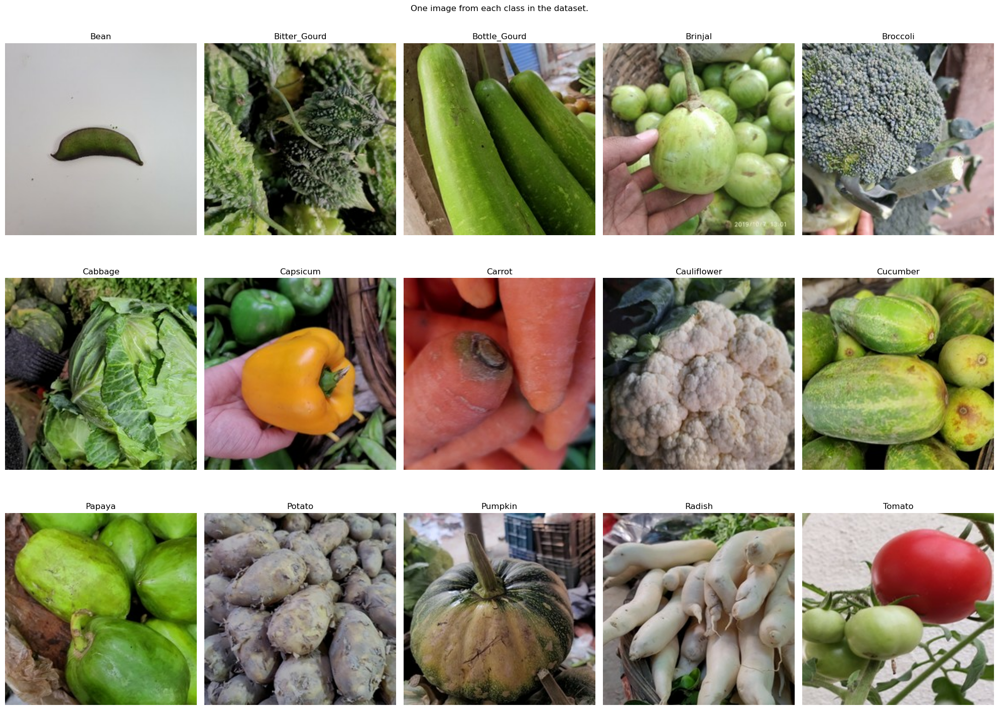

In [7]:
cnnf.class_image(normal_full_data, class_names, cmap = "gray")

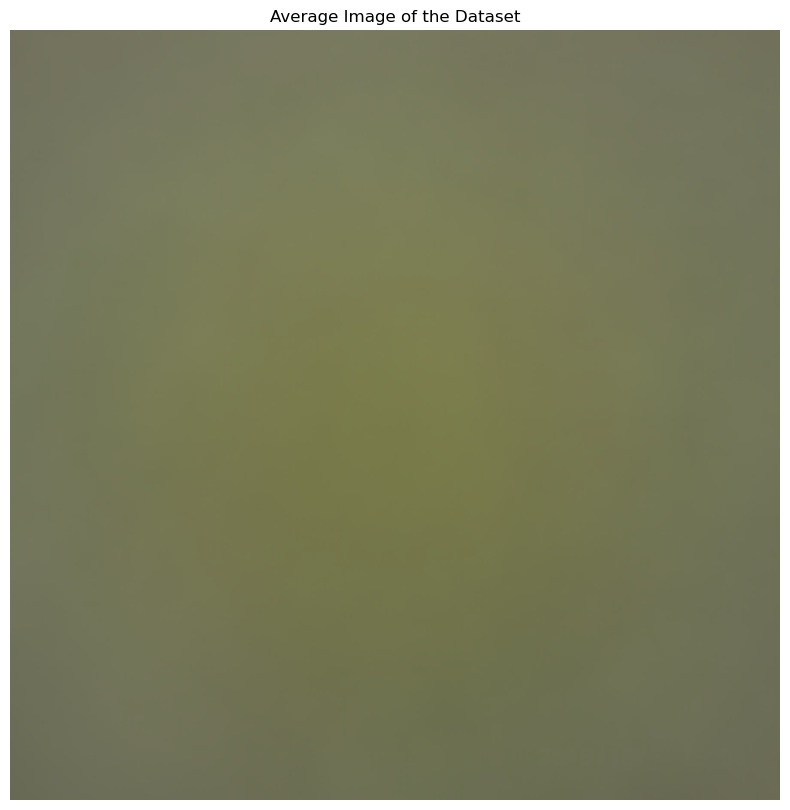

In [8]:
cnnf.average_image(normal_full_data)

From the above, which is a average of all the pictures in our dataset, we can see that there are no outstanding features in the dataset. The dataset also appears to be uniform, with the dominant color being green. The dataset also seems to be homogenous, with most of the details being shared accross the images.
<br>
<br>
These may all pose challenges to us later, as the model may not have enough features to identify the different types of vegetables.

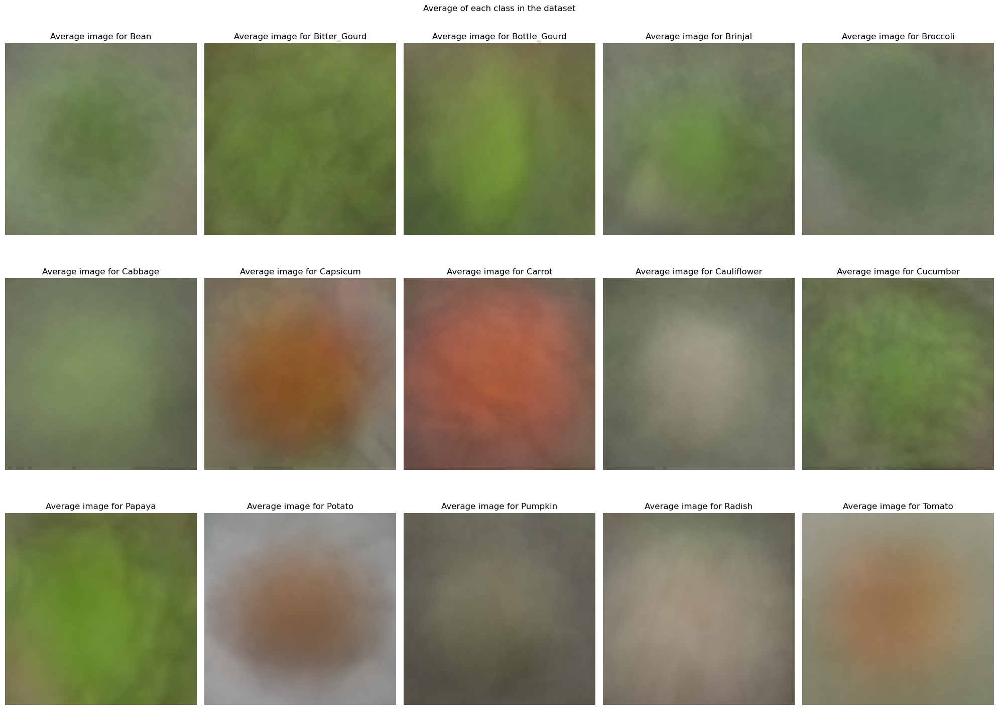

In [9]:
cnnf.average_images_per_class(normal_full_data, class_names)

From the above, we can see that there are 3 distinct colors in the dataset, with **Capsicums**, **Carrots**, **Potatoes**, and **Tomatoes** having high red values, while **Cauliflowers**, **Pumpkins**, and **Radishes** being more white, meaning that they are higher in all color channels. The rest of the vegetables have greener average images, showing that they have a higher load in the green color channel.
<br>
<br>
This means that when we greyscale images later, there may be important data lost which affects the accuracy of the model.
<br>
<br>
We can also see that most images look similar when averaged, with most just being a circular blob. This means that the shape of most vegetables also matter to the model, and might be a important component in classification.
<br>
<br>
This matters, as it means that when the images are downsized later, we may lose some data, causing the accuracy to further suffer.

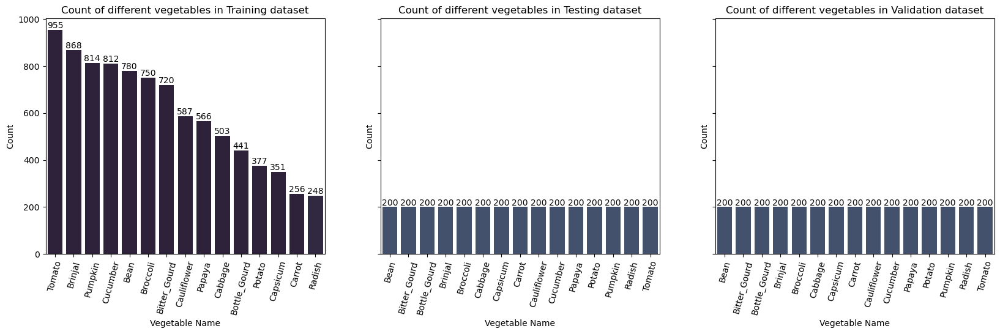

In [10]:
fig, axs = plt.subplots(1,3, sharey=True, figsize = (20,5))

cnnf.image_count_graph(train_sample_count , ax = axs[0], set_name = "Training")
cnnf.image_count_graph(test_sample_count, ax = axs[1], set_name = "Testing")
cnnf.image_count_graph(validation_sample_count, ax = axs[2], set_name = "Validation")

plt.show()

From the above, we can see that the dataset is imbalanced.

In [11]:
mean_val, std_val = cnnf.compute_running_mean_std(normal_full_data)
print(f"The mean brightness of all images is {mean_val}")
print(f"The standard deviation of all images is {std_val}")

The mean brightness of all images is 0.4197029846784955
The standard deviation of all images is 0.24243864096348536


<font size = 2>(Note: we scaled the scalars of the image to be from 0 to 1 earlier.)</font>
<br>
From the above, we can see that the mean brightness of all images is 0.419. This tells us that the data is not extremely bright. In addition, there is also limited variation in the data given (0.23995).

<hr>
<font size = 5>Establishing baseline models.</font>
<hr>

To help us identify the best data preparation pipeline, we shall establish a baseline model, then test it out on the different steps, to see which steps are the right ones to take to improve the accuracy of the model. As a baseline model, we shall use a simple convolutional neural network, using tensorflow's Conv2D layers. These are better suited for image classification tasks compared to other layers such as the Dense layers, due to their ability to work on local regions of the image, allowing it to detect features such as edges and patterns. This allows it to understand the structure and content of an image better than other types of models. In addition, we shall use *Sparse Categorical Crossentropy* over other types of entropy loss functions, as it is better suited to the nature of our dataset. *Sparse Categorical Crossentropy* is useful when handling a larger amount of classes, like our use case here. If we were to one-hot encode the labels, like is needed for *Categorical Crossentropy*, we would have generated larger, sparser matrices, which are inefficent when it comes to memory usage. *Sparse Categorical Crossentropy* also directly uses class labels instead of one-hot encoded vectores, allowing us to skip a step in the data preparation pipeline, simplifying the data pre-preprocessing. 

The formula for *Sparse Categorical Crossentropy* is as follows:

\begin{aligned}
L &= -\sum_{i=1}^{N} \log(p_{y_i}) \\
\text{where} \\
L &\text{ is the loss} \\
N &\text{ is the number of samples in the dataset} \\
y_i &\text{ is the true class label for the } i\text{-th sample} \\
p_{y_i} &\text{ is the predicted probability of the true class } y_i \text{ for the } i\text{-th sample}
\end{aligned}

<br>

Furthermore, we shall use the *Adam* optimizer first. **ADA**ptive **M**oment Estimation is a extension of Stochastic Gradient Descent. It combines ideas from two other optimization algorithms, namely _Momentum_ and _RMSProp_. It is a good choice for us to start with, given it's "self-learning" properties, which means that it's learning rates are adaptive, relative to how frequently a parameter gets updated while training, making it suitable for problems with sparse gradients or with noisy data, like ours. It is also omputationally efficient with relatively low memory requirements, making it suitable for problems with large datasets or parameters.

In [13]:
earlyStopper = EarlyStopping(monitor = 'val_loss', patience = 10)

In [56]:
num_classes = len(class_names)

baseline_model = Sequential()
baseline_model.add(Conv2D(16, (3, 3), activation='relu'))
baseline_model.add(MaxPooling2D((2, 2)))
baseline_model.add(Conv2D(32, (3, 3), activation='relu'))
baseline_model.add(GlobalAveragePooling2D())
baseline_model.add(Dense(num_classes, activation='softmax'))
baseline_model.compile(loss = "sparse_categorical_crossentropy", optimizer = "adam", metrics = ["accuracy"])

baseline31_model = clone_model(baseline_model)
baseline31luminosity_model = clone_model(baseline_model)
baseline31desaturation_model = clone_model(baseline_model)
baseline128_model = clone_model(baseline_model)
baseline128luminosity_model = clone_model(baseline_model)
baseline128desaturation_model = clone_model(baseline_model)
baseline31_model.compile(loss = "sparse_categorical_crossentropy", optimizer = "adam", metrics = ["accuracy"])
baseline31luminosity_model.compile(loss = "sparse_categorical_crossentropy", optimizer = "adam", metrics = ["accuracy"])
baseline31desaturation_model.compile(loss = "sparse_categorical_crossentropy", optimizer = "adam", metrics = ["accuracy"])
baseline128_model.compile(loss = "sparse_categorical_crossentropy", optimizer = "adam", metrics = ["accuracy"])
baseline128luminosity_model.compile(loss = "sparse_categorical_crossentropy", optimizer = "adam", metrics = ["accuracy"])
baseline128desaturation_model.compile(loss = "sparse_categorical_crossentropy", optimizer = "adam", metrics = ["accuracy"])

<hr>
<font size = 5>Data Preparation.</font>
<hr>

To prepare the data to make it ready for the model, we need to 
1) Greyscale the data
2) Resize to both `31 x 31` and `128 x 128` pixels.

We shall start by resizing the data, then moving onto investigating the different methods that can be used to greyscale the data.

In [8]:
def resize_image(image, label, target_height=31, target_width=31):
    image = tf.image.resize(image, [target_height, target_width])
    return image, label

res31_train_data = normal_train_data.map(lambda image, label: resize_image(image, label, 31, 31), num_parallel_calls=tf.data.AUTOTUNE)
res31_test_data = normal_test_data.map(lambda image, label: resize_image(image, label, 31, 31), num_parallel_calls=tf.data.AUTOTUNE)
res31_validation_data = normal_validation_data.map(lambda image, label: resize_image(image, label, 31, 31), num_parallel_calls=tf.data.AUTOTUNE)  
res31_full_data = res31_train_data.concatenate(res31_test_data)
res31_full_data = res31_full_data.concatenate(res31_validation_data)

res128_train_data = normal_train_data.map(lambda image, label: resize_image(image, label, 128, 128), num_parallel_calls=tf.data.AUTOTUNE)
res128_test_data = normal_test_data.map(lambda image, label: resize_image(image, label, 128, 128), num_parallel_calls=tf.data.AUTOTUNE)
res128_validation_data = normal_validation_data.map(lambda image, label: resize_image(image, label, 128, 128), num_parallel_calls=tf.data.AUTOTUNE)  
res128_full_data = res128_train_data.concatenate(res128_test_data)
res128_full_data = res128_full_data.concatenate(res128_validation_data)

We shall start by using the simplest method to greyscale the images, by averaging out all 3 color channels, to obtain the average brightness of each image.

In [9]:
def convert_to_greyscale(image, label):
    image = tf.image.rgb_to_grayscale(image)
    return image, label

res31greyscale_train_data = res31_train_data.map(lambda image, label: convert_to_greyscale(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res31greyscale_test_data = res31_test_data.map(lambda image, label: convert_to_greyscale(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res31greyscale_validation_data = res31_validation_data.map(lambda image, label: convert_to_greyscale(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res31greyscale_full_data = res31greyscale_train_data.concatenate(res31greyscale_test_data)
res31greyscale_full_data = res31greyscale_full_data.concatenate(res31greyscale_validation_data)
res31greyscale_full_data = res31greyscale_full_data.unbatch()


res128greyscale_train_data = res128_train_data.map(lambda image, label: convert_to_greyscale(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res128greyscale_test_data = res128_test_data.map(lambda image, label: convert_to_greyscale(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res128greyscale_validation_data = res128_validation_data.map(lambda image, label: convert_to_greyscale(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res128greyscale_full_data = res128greyscale_train_data.concatenate(res128greyscale_test_data)
res128greyscale_full_data = res128greyscale_full_data.concatenate(res128greyscale_validation_data)
res128greyscale_full_data = res128greyscale_full_data.unbatch()

Next, we shall use the luminosity method to greyscale the images. This works by adjusting the strength of the color channels based on the perception of the human eye, since it does not respond equally to all colors. The formula for the luminosity method is as follows
$$
\text Grey = 0.21×Red+0.72×Green+0.07×Blue
$$

In [10]:
def convert_to_greyscale_luminosity(image, label):
    luminosity_weights = tf.constant([0.21, 0.72, 0.07], shape=(1, 1, 3), dtype=image.dtype)
    grayscale_image = tf.reduce_sum(image * luminosity_weights, axis=-1, keepdims=True)
    return grayscale_image, label

res31luminosity_train_data = res31_train_data.map(lambda image, label: convert_to_greyscale_luminosity(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res31luminosity_test_data = res31_test_data.map(lambda image, label: convert_to_greyscale_luminosity(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res31luminosity_validation_data = res31_validation_data.map(lambda image, label: convert_to_greyscale_luminosity(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res31luminosity_full_data = res31luminosity_train_data.concatenate(res31luminosity_test_data)
res31luminosity_full_data = res31luminosity_full_data.concatenate(res31luminosity_validation_data)
res31luminosity_full_data = res31luminosity_full_data.unbatch()


res128luminosity_train_data = res128_train_data.map(lambda image, label: convert_to_greyscale_luminosity(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res128luminosity_test_data = res128_test_data.map(lambda image, label: convert_to_greyscale_luminosity(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res128luminosity_validation_data = res128_validation_data.map(lambda image, label: convert_to_greyscale_luminosity(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res128luminosity_full_data = res128luminosity_train_data.concatenate(res128luminosity_test_data)
res128luminosity_full_data = res128luminosity_full_data.concatenate(res128luminosity_validation_data)
res128luminosity_full_data = res128luminosity_full_data.unbatch()

Lastly, we shall use the desaturation method to greyscale the images. The method calculates the grey level by averaging the maximum and minimum values of the RGB components for each pixel. The formula for the desaturation method is as follows:
$$
\text{Gray} = \frac{\text{max(Red, Green, Blue)} + \text{min(Red, Green, Blue)}}{2}
$$

In [11]:
def convert_to_greyscale_desaturation(image, label):
    max_rgb = tf.reduce_max(image, axis=-1, keepdims=True)
    min_rgb = tf.reduce_min(image, axis=-1, keepdims=True)
    grayscale_image = (max_rgb + min_rgb) / 2
    return grayscale_image, label

res31desaturation_train_data = res31_train_data.map(lambda image, label: convert_to_greyscale_desaturation(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res31desaturation_test_data = res31_test_data.map(lambda image, label: convert_to_greyscale_desaturation(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res31desaturation_validation_data = res31_validation_data.map(lambda image, label: convert_to_greyscale_desaturation(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res31desaturation_full_data = res31desaturation_train_data.concatenate(res31desaturation_test_data)
res31desaturation_full_data = res31desaturation_full_data.concatenate(res31desaturation_validation_data)
res31desaturation_full_data = res31desaturation_full_data.unbatch()

res128desaturation_train_data = res128_train_data.map(lambda image, label: convert_to_greyscale_desaturation(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res128desaturation_test_data = res128_test_data.map(lambda image, label: convert_to_greyscale_desaturation(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res128desaturation_validation_data = res128_validation_data.map(lambda image, label: convert_to_greyscale_desaturation(image, label), num_parallel_calls= tf.data.AUTOTUNE)
res128desaturation_full_data = res128desaturation_train_data.concatenate(res128desaturation_test_data)
res128desaturation_full_data = res128desaturation_full_data.concatenate(res128desaturation_validation_data)
res128desaturation_full_data = res128desaturation_full_data.unbatch()


<hr>
Greyscale validation (31 x 31 image)
<hr>

Epoch 1/150


283/283 [==============================] - 6s 17ms/step - loss: 2.6087 - accuracy: 0.1283 - val_loss: 2.7094 - val_accuracy: 0.1067
Epoch 2/150
283/283 [==============================] - 5s 18ms/step - loss: 2.5015 - accuracy: 0.1799 - val_loss: 2.6120 - val_accuracy: 0.1570
Epoch 3/150
283/283 [==============================] - 5s 17ms/step - loss: 2.4232 - accuracy: 0.2180 - val_loss: 2.4869 - val_accuracy: 0.1710
Epoch 4/150
283/283 [==============================] - 5s 17ms/step - loss: 2.3518 - accuracy: 0.2312 - val_loss: 2.4270 - val_accuracy: 0.1720
Epoch 5/150
283/283 [==============================] - 5s 17ms/step - loss: 2.2896 - accuracy: 0.2518 - val_loss: 2.3637 - val_accuracy: 0.1890
Epoch 6/150
283/283 [==============================] - 5s 16ms/step - loss: 2.2534 - accuracy: 0.2575 - val_loss: 2.3032 - val_accuracy: 0.2070
Epoch 7/150
283/283 [==============================] - 5s 16ms/step - loss: 2.2163 - accuracy: 0.2841 - val_loss: 2.3038 - val_accuracy: 0.2103
Epoc

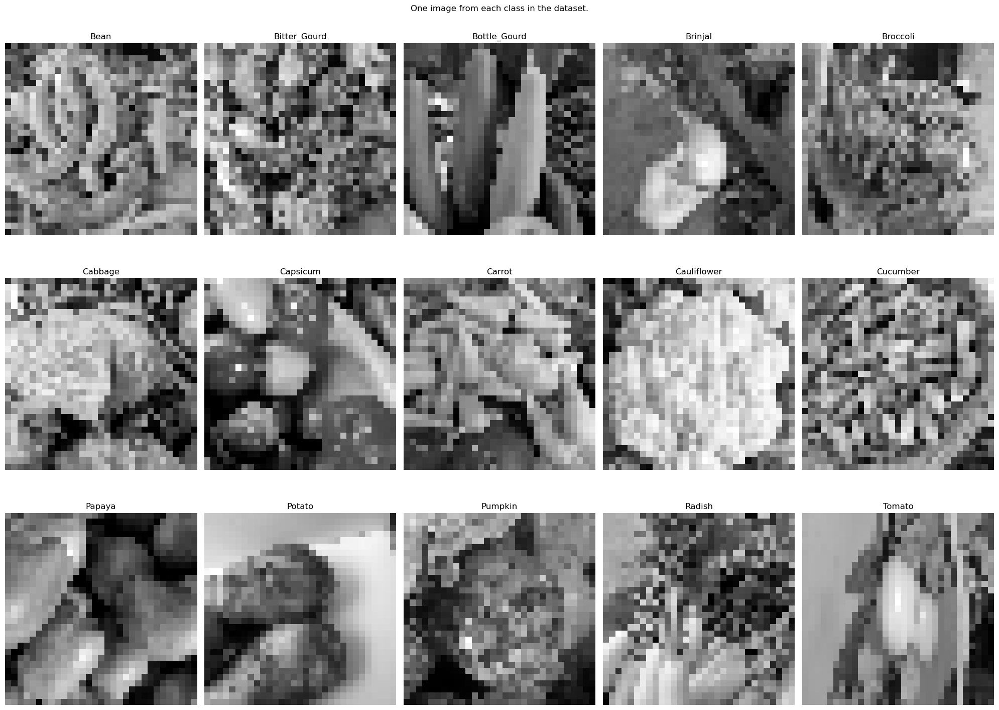

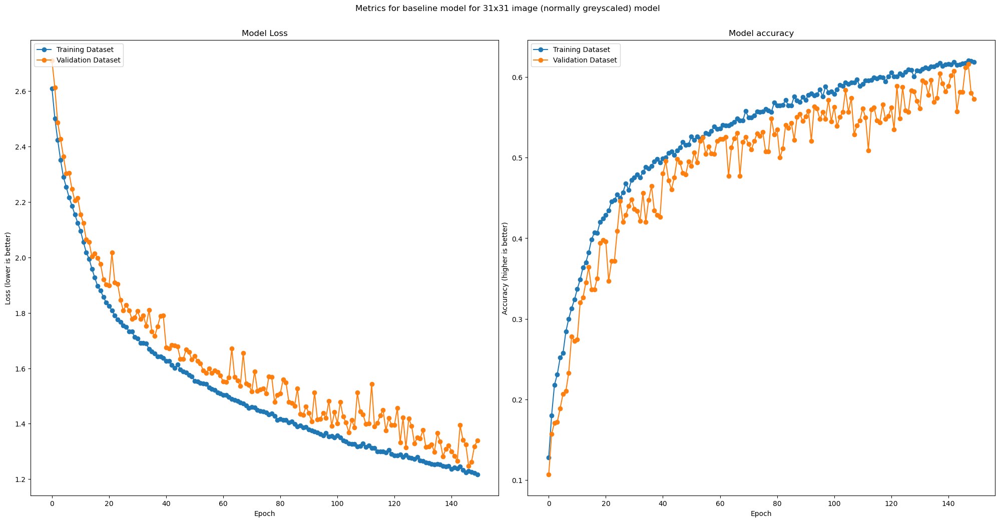

In [57]:
history = baseline31_model.fit(res31greyscale_train_data, validation_data = res31greyscale_validation_data, epochs = 150, callbacks = earlyStopper)
cnnf.class_image(res31greyscale_full_data, class_names, cmap = "gray")
cnnf.model_metric_graph(history, baseline31_model, res31greyscale_validation_data, class_names= class_names,name = "baseline model for 31x31 image (normally greyscaled)")

Epoch 1/150


283/283 [==============================] - 5s 17ms/step - loss: 2.6063 - accuracy: 0.1224 - val_loss: 2.7064 - val_accuracy: 0.0887
Epoch 2/150
283/283 [==============================] - 5s 17ms/step - loss: 2.5028 - accuracy: 0.1694 - val_loss: 2.6157 - val_accuracy: 0.1403
Epoch 3/150
283/283 [==============================] - 5s 16ms/step - loss: 2.4363 - accuracy: 0.1951 - val_loss: 2.5341 - val_accuracy: 0.1583
Epoch 4/150
283/283 [==============================] - 5s 16ms/step - loss: 2.3626 - accuracy: 0.2148 - val_loss: 2.4281 - val_accuracy: 0.1800
Epoch 5/150
283/283 [==============================] - 5s 16ms/step - loss: 2.2896 - accuracy: 0.2312 - val_loss: 2.4209 - val_accuracy: 0.1653
Epoch 6/150
283/283 [==============================] - 5s 16ms/step - loss: 2.2509 - accuracy: 0.2455 - val_loss: 2.2842 - val_accuracy: 0.1897
Epoch 7/150
283/283 [==============================] - 5s 17ms/step - loss: 2.2125 - accuracy: 0.2550 - val_loss: 2.2573 - val_accuracy: 0.2180
Epoc

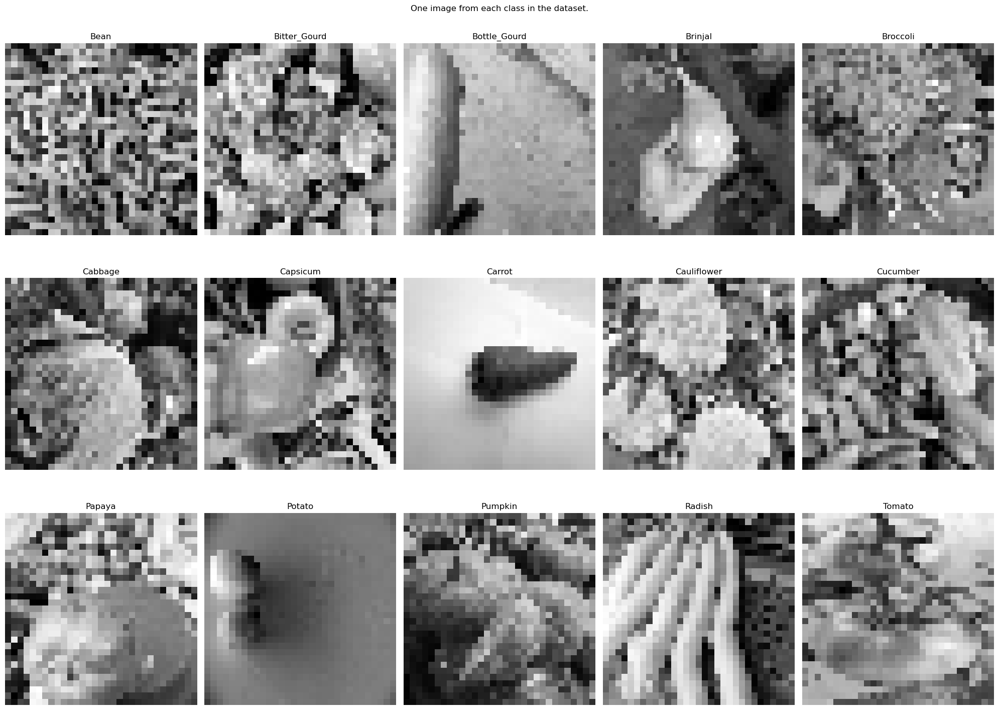

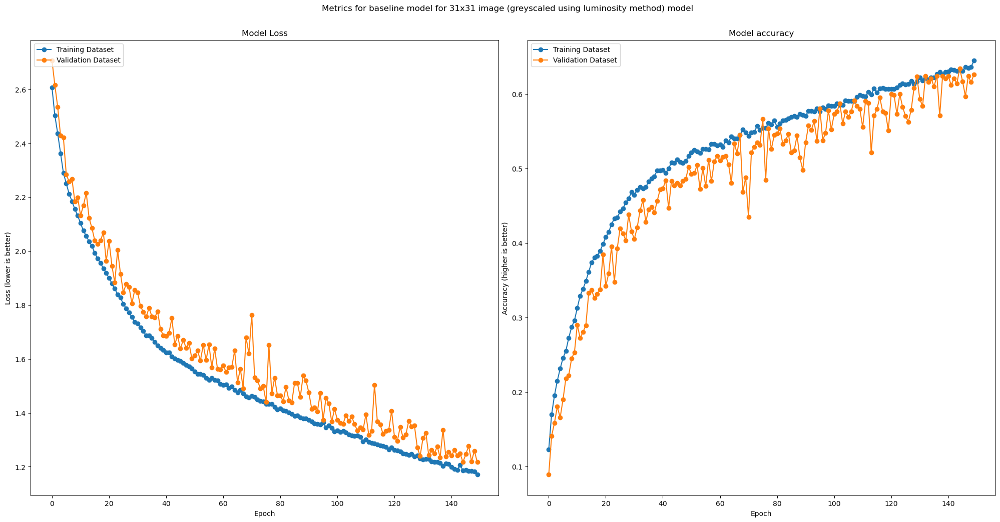

In [58]:
history = baseline31luminosity_model.fit(res31luminosity_train_data, validation_data = res31luminosity_validation_data, epochs = 150, callbacks = earlyStopper)
cnnf.class_image(res31luminosity_full_data, class_names, cmap = "gray")
cnnf.model_metric_graph(history, baseline31luminosity_model, res31luminosity_validation_data, class_names= class_names,name = "baseline model for 31x31 image (greyscaled using luminosity method)")

Epoch 1/150


283/283 [==============================] - 5s 17ms/step - loss: 2.6026 - accuracy: 0.1380 - val_loss: 2.7011 - val_accuracy: 0.1083
Epoch 2/150
283/283 [==============================] - 5s 16ms/step - loss: 2.4533 - accuracy: 0.2009 - val_loss: 2.5655 - val_accuracy: 0.1530
Epoch 3/150
283/283 [==============================] - 5s 16ms/step - loss: 2.3437 - accuracy: 0.2509 - val_loss: 2.4339 - val_accuracy: 0.1813
Epoch 4/150
283/283 [==============================] - 5s 17ms/step - loss: 2.2562 - accuracy: 0.2829 - val_loss: 2.3488 - val_accuracy: 0.2227
Epoch 5/150
283/283 [==============================] - 5s 16ms/step - loss: 2.1928 - accuracy: 0.3139 - val_loss: 2.3247 - val_accuracy: 0.2287
Epoch 6/150
283/283 [==============================] - 5s 16ms/step - loss: 2.1545 - accuracy: 0.3293 - val_loss: 2.2466 - val_accuracy: 0.2720
Epoch 7/150
283/283 [==============================] - 5s 16ms/step - loss: 2.1193 - accuracy: 0.3404 - val_loss: 2.2192 - val_accuracy: 0.2880
Epoc

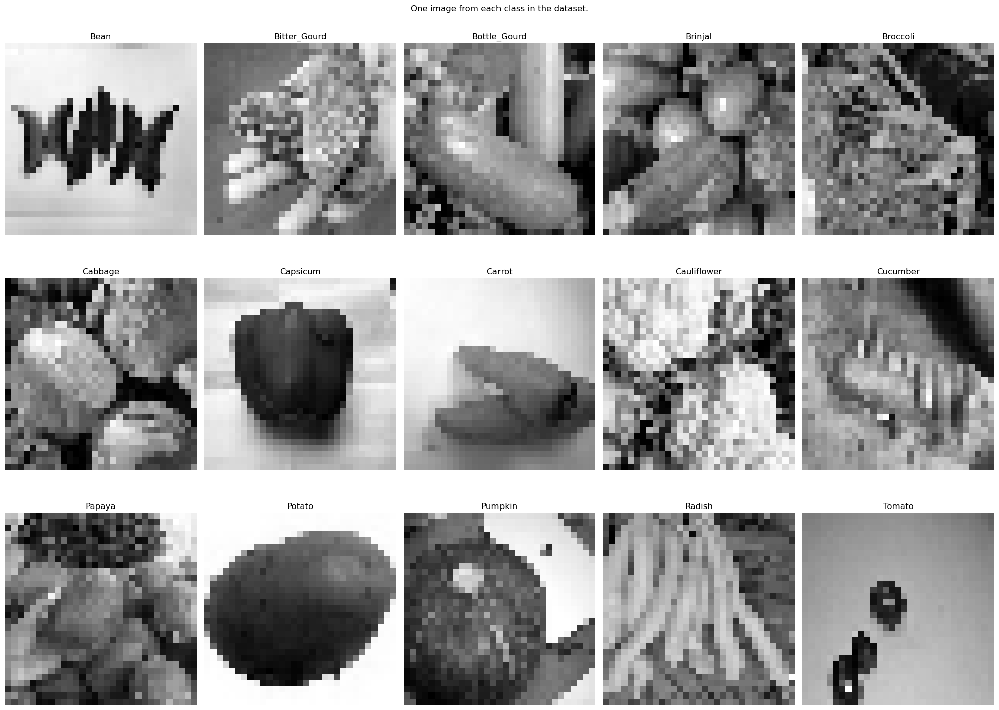

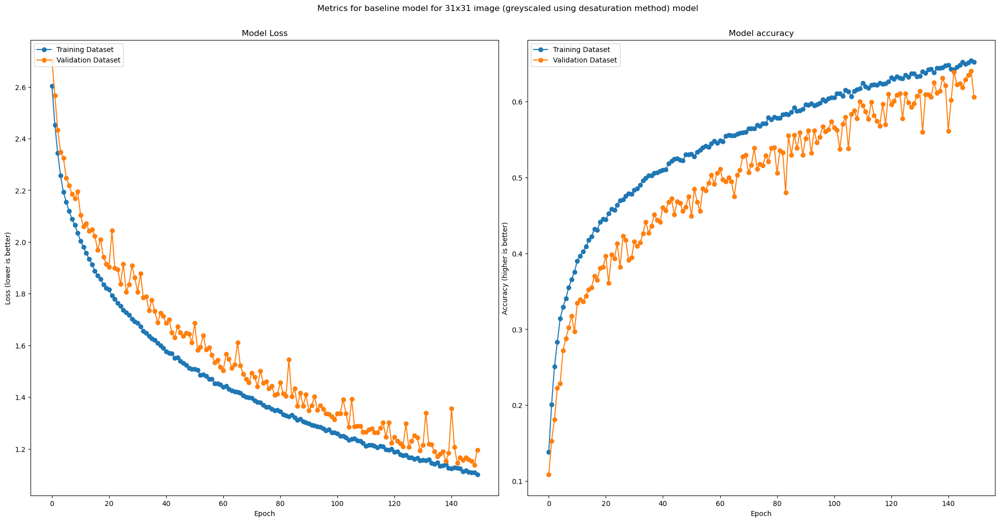

In [59]:
history = baseline31desaturation_model.fit(res31desaturation_train_data, validation_data = res31desaturation_validation_data, epochs = 150, callbacks = earlyStopper)
cnnf.class_image(res31desaturation_full_data, class_names, cmap = "gray")
cnnf.model_metric_graph(history, baseline31desaturation_model, res31desaturation_validation_data, class_names= class_names,name = "baseline model for 31x31 image (greyscaled using desaturation method)")

<hr>
Greyscale validation (128 x 128 image)
<hr>

Epoch 1/150


283/283 [==============================] - 6s 18ms/step - loss: 2.6408 - accuracy: 0.1078 - val_loss: 2.7554 - val_accuracy: 0.1153
Epoch 2/150
283/283 [==============================] - 5s 18ms/step - loss: 2.5569 - accuracy: 0.1781 - val_loss: 2.6903 - val_accuracy: 0.1213
Epoch 3/150
283/283 [==============================] - 5s 18ms/step - loss: 2.4801 - accuracy: 0.2049 - val_loss: 2.6167 - val_accuracy: 0.1713
Epoch 4/150
283/283 [==============================] - 6s 18ms/step - loss: 2.4137 - accuracy: 0.2424 - val_loss: 2.5369 - val_accuracy: 0.1783
Epoch 5/150
283/283 [==============================] - 6s 20ms/step - loss: 2.3513 - accuracy: 0.2604 - val_loss: 2.5079 - val_accuracy: 0.1960
Epoch 6/150
283/283 [==============================] - 6s 18ms/step - loss: 2.2922 - accuracy: 0.2734 - val_loss: 2.4538 - val_accuracy: 0.2010
Epoch 7/150
283/283 [==============================] - 6s 18ms/step - loss: 2.2458 - accuracy: 0.2854 - val_loss: 2.4360 - val_accuracy: 0.1957
Epoc

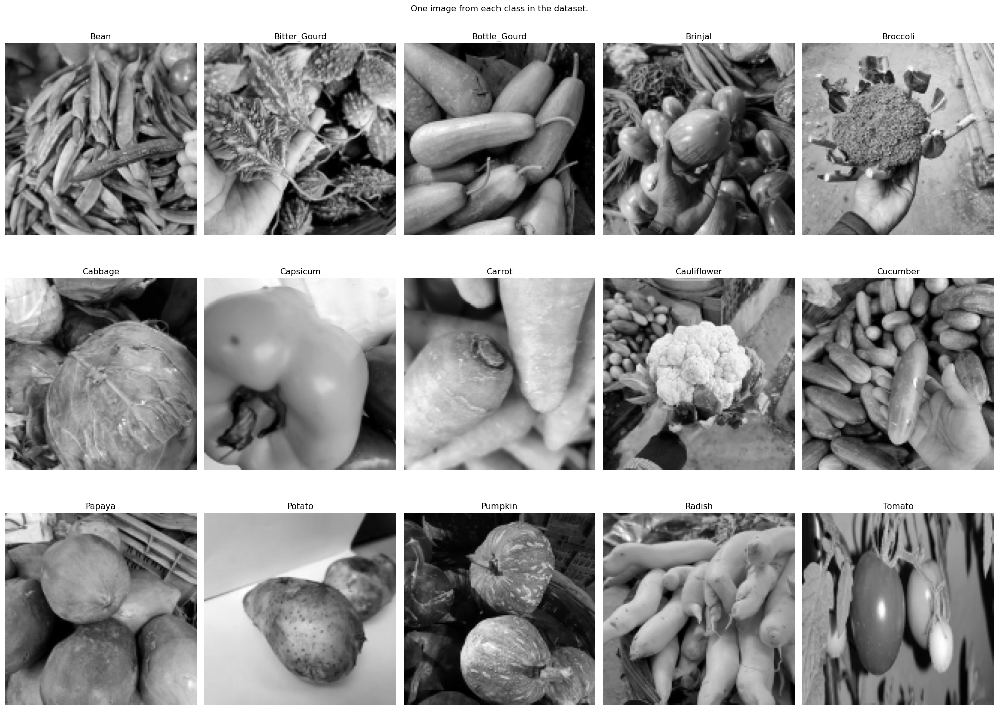

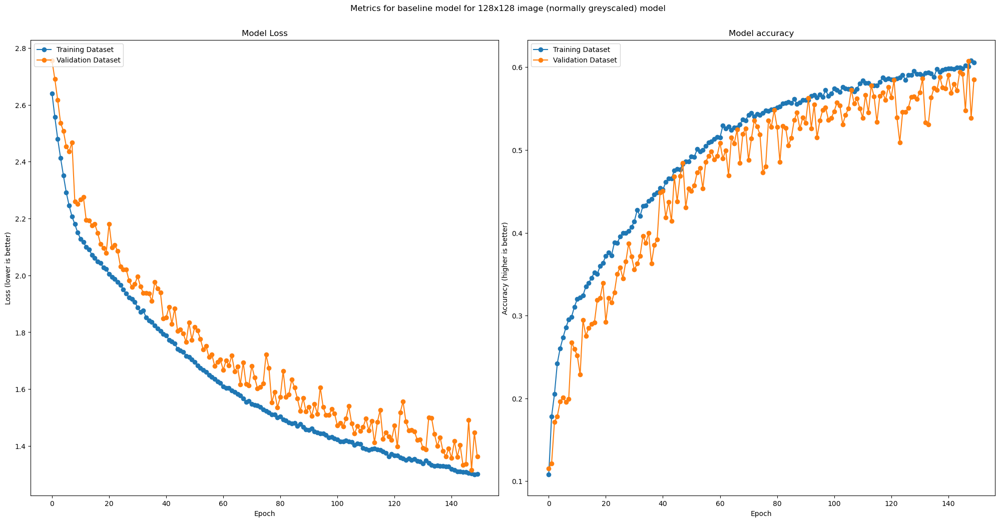

In [62]:
history = baseline128_model.fit(res128greyscale_train_data, validation_data = res128greyscale_validation_data, epochs = 150, callbacks = earlyStopper)
cnnf.class_image(res128greyscale_full_data, class_names, cmap = "gray")
cnnf.model_metric_graph(history, baseline128_model, res128greyscale_validation_data, name = "baseline model for 128x128 image (normally greyscaled)", class_names = class_names)

In [52]:
baseline128greyscale_model = clone_model(baseline_model)
baseline128greyscale_model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])


Epoch 1/150


283/283 [==============================] - 5s 17ms/step - loss: 2.6276 - accuracy: 0.1135 - val_loss: 2.7736 - val_accuracy: 0.1150
Epoch 2/150
283/283 [==============================] - 5s 17ms/step - loss: 2.5313 - accuracy: 0.1917 - val_loss: 2.6425 - val_accuracy: 0.1773
Epoch 3/150
283/283 [==============================] - 5s 17ms/step - loss: 2.4202 - accuracy: 0.2336 - val_loss: 2.5386 - val_accuracy: 0.1793
Epoch 4/150
283/283 [==============================] - 5s 17ms/step - loss: 2.3292 - accuracy: 0.2621 - val_loss: 2.4175 - val_accuracy: 0.2170
Epoch 5/150
283/283 [==============================] - 5s 18ms/step - loss: 2.2522 - accuracy: 0.2785 - val_loss: 2.3220 - val_accuracy: 0.2300
Epoch 6/150
283/283 [==============================] - 5s 17ms/step - loss: 2.2048 - accuracy: 0.2894 - val_loss: 2.2824 - val_accuracy: 0.2573
Epoch 7/150
283/283 [==============================] - 5s 18ms/step - loss: 2.1712 - accuracy: 0.3044 - val_loss: 2.3325 - val_accuracy: 0.2110
Epoc

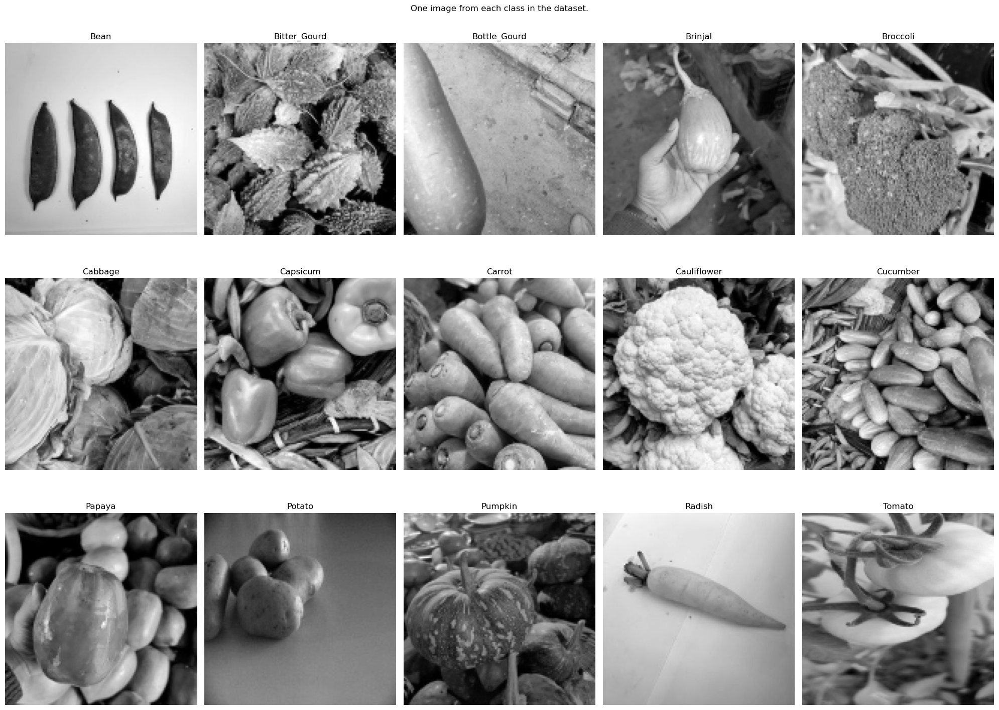

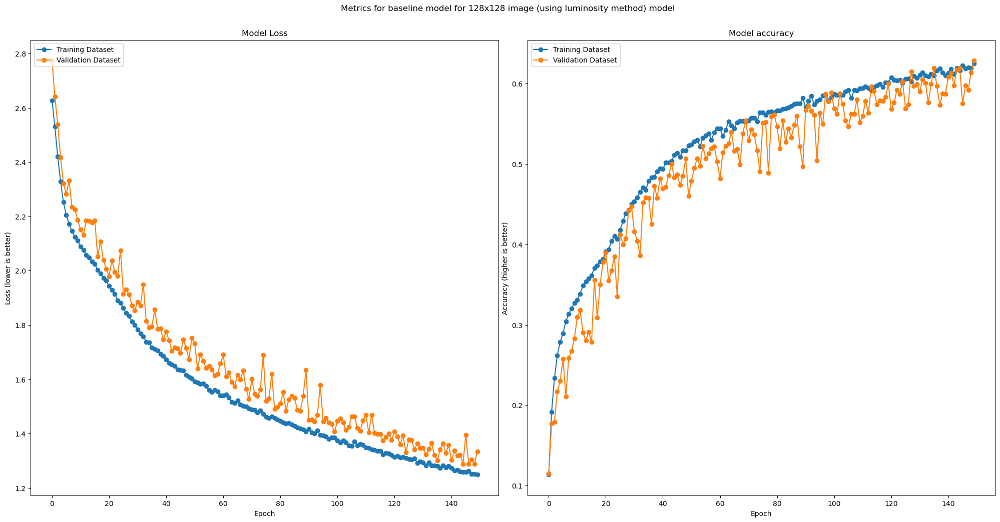

In [63]:
history = baseline128luminosity_model.fit(res128luminosity_train_data, validation_data = res128luminosity_validation_data, epochs = 150, callbacks = earlyStopper)
cnnf.class_image(res128luminosity_full_data, class_names, cmap = "gray")
cnnf.model_metric_graph(history, baseline128luminosity_model, res128luminosity_validation_data, name = "baseline model for 128x128 image (using luminosity method)", class_names = class_names)

Epoch 1/150


283/283 [==============================] - 7s 20ms/step - loss: 2.6102 - accuracy: 0.1426 - val_loss: 2.7569 - val_accuracy: 0.1147
Epoch 2/150
283/283 [==============================] - 6s 20ms/step - loss: 2.4965 - accuracy: 0.1989 - val_loss: 2.6472 - val_accuracy: 0.1853
Epoch 3/150
283/283 [==============================] - 6s 20ms/step - loss: 2.4159 - accuracy: 0.2409 - val_loss: 2.5997 - val_accuracy: 0.1730
Epoch 4/150
283/283 [==============================] - 6s 20ms/step - loss: 2.3631 - accuracy: 0.2584 - val_loss: 2.5061 - val_accuracy: 0.2063
Epoch 5/150
283/283 [==============================] - 6s 20ms/step - loss: 2.3123 - accuracy: 0.2720 - val_loss: 2.4435 - val_accuracy: 0.2197
Epoch 6/150
283/283 [==============================] - 6s 19ms/step - loss: 2.2634 - accuracy: 0.2812 - val_loss: 2.3851 - val_accuracy: 0.2160
Epoch 7/150
283/283 [==============================] - 6s 18ms/step - loss: 2.2193 - accuracy: 0.3036 - val_loss: 2.3640 - val_accuracy: 0.2280
Epoc

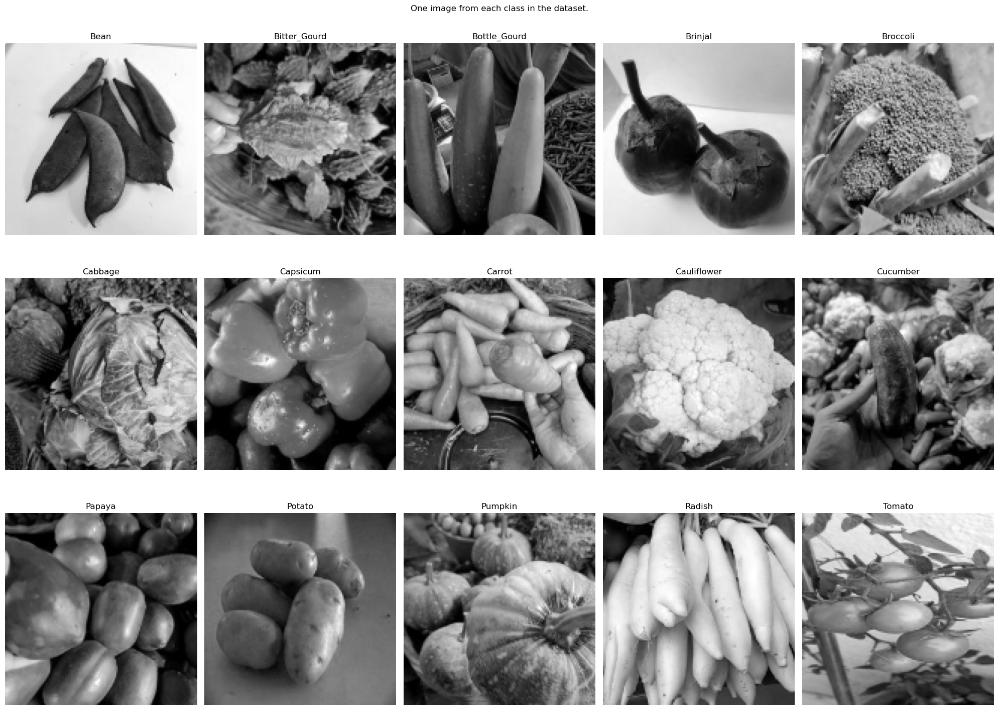

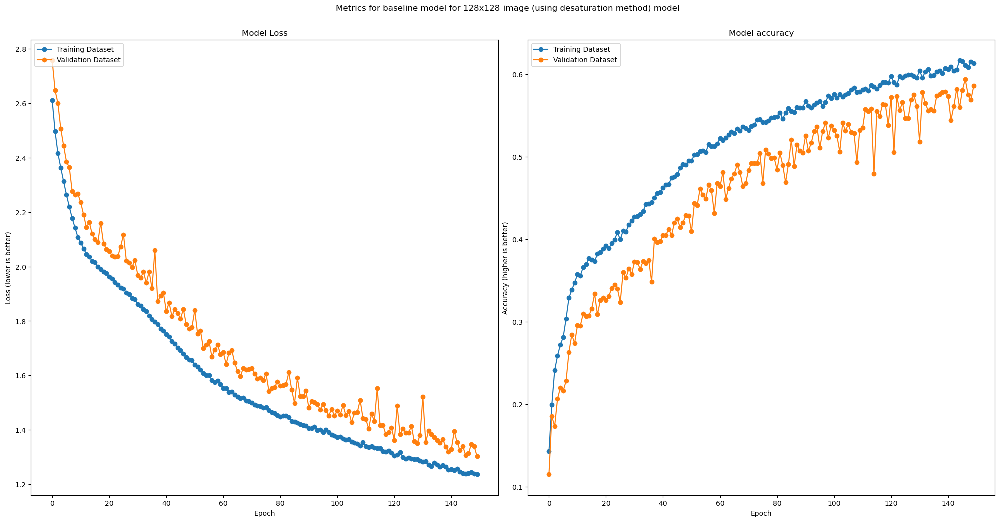

In [64]:
history = baseline128desaturation_model.fit(res128desaturation_train_data, validation_data = res128desaturation_validation_data, epochs = 150, callbacks = earlyStopper)
cnnf.class_image(res128desaturation_full_data, class_names, cmap = "gray")
cnnf.model_metric_graph(history, baseline128desaturation_model, res128desaturation_validation_data, name = "baseline model for 128x128 image (using desaturation method)", class_names = class_names)

<hr>
Greyscale Conclusion (31 x 31)
<hr>

94/94 [==============================] - 1s 11ms/step - loss: 1.1963 - accuracy: 0.6060


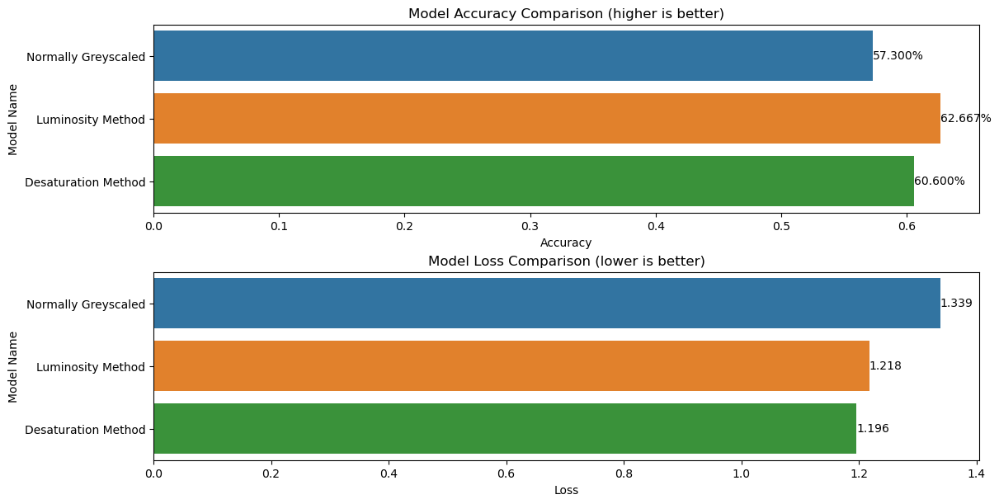

In [60]:
res31_model_list = [baseline31_model, baseline31luminosity_model, baseline31desaturation_model]
res31_data_list = [res31greyscale_validation_data, res31luminosity_validation_data, res31desaturation_validation_data]
name_list = ["Normally Greyscaled", "Luminosity Method", "Desaturation Method"]
cnnf.model_comparison(res31_model_list, res31_data_list, name_list)

From the above, we can see that for the `31 x 31` image size, the *Luminosity Method* is the best to use, yielding the highest overall classification accuracy, and the second-best model loss. Hence, for the `31 x 31` image size, we shall use the images greyscaled with the _Luminosity_ method.

<hr>
Greyscale Conclusion (128 x 128)
<hr>

94/94 [==============================] - 2s 14ms/step - loss: 1.3032 - accuracy: 0.5860


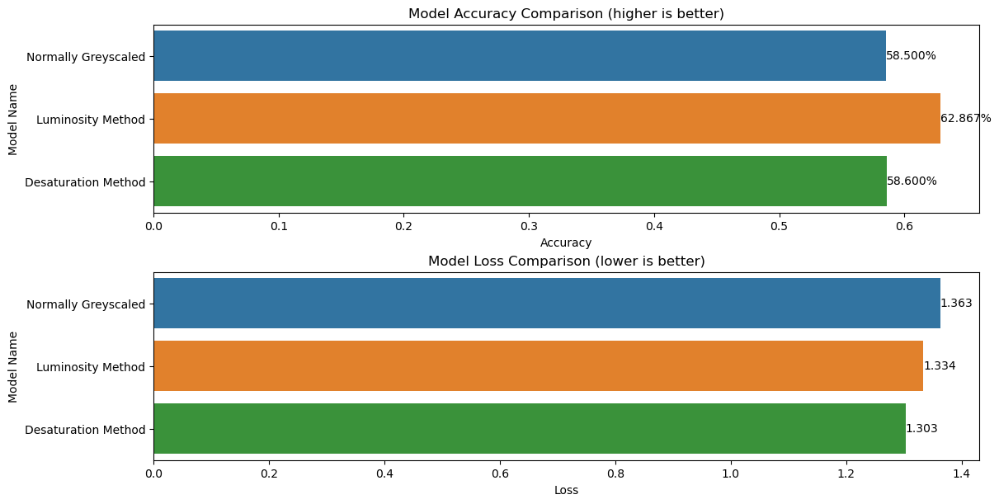

In [65]:
res128_model_list = [baseline128_model, baseline128luminosity_model, baseline128desaturation_model]
res128_data_list = [res128greyscale_validation_data, res128luminosity_validation_data, res128desaturation_validation_data]
name_list = ["Normally Greyscaled", "Luminosity Method", "Desaturation Method"]
cnnf.model_comparison(res128_model_list, res128_data_list, name_list)

From the above comparison, we can see that for the `128 x 128` image size, the _Luminosity Method_ is the best to use, as it gives the highest overall classification accuracy, as well as the second-best overall loss. Hence, we shall continue with the `128 x 128` image size using data greyscaled by the _Luminosity Method_.

Visualization of baseline model for 31 x 31 images.

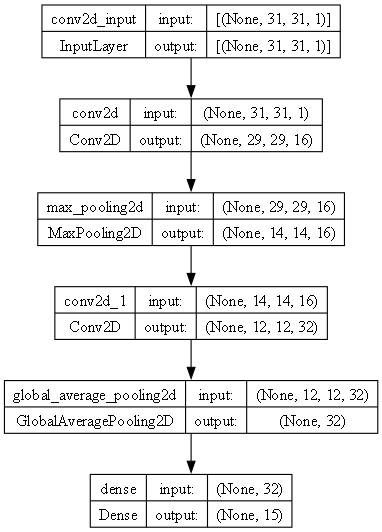

In [27]:
tf.keras.utils.plot_model(baseline31_model, show_shapes=True, dpi=80)

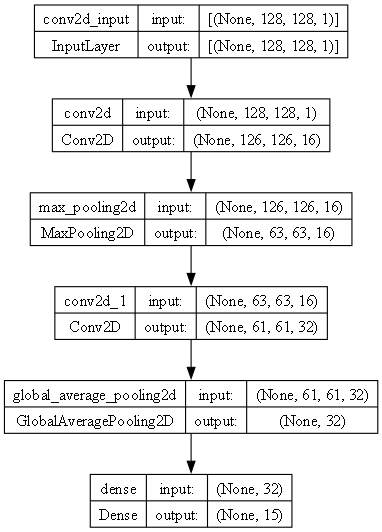

In [28]:
tf.keras.utils.plot_model(baseline128_model, show_shapes=True, dpi=80)

<hr>
<font size = 5>Finalizing Data</font>
<hr>

Now, we shall normalize the final greyscaled data. Earlier on in the dataset, we did some basic normalization, namely, dividing it by 255. However, we shall now go a step further and shift the values, obtaining a standard deviation of 1, and a mean of 0.5 using Standardization. The formula for standardization is as follows:
$$
\text Normalized\enspace Pixel\enspace Value = \frac{Pixel Value - \mu}{\theta}
$$

In [12]:
def compute_mean_std(dataset, batch_size=32):
    sum_images = 0
    sum_sq_images = 0
    num_samples = 0

    for images, _ in dataset.batch(batch_size):
        sum_images += tf.reduce_sum(images, axis=[0, 1, 2])
        sum_sq_images += tf.reduce_sum(tf.square(images), axis=[0, 1, 2])
        num_samples += tf.cast(tf.reduce_prod(tf.shape(images)[0:3]), tf.float32)

    mean = sum_images / num_samples
    variance = (sum_sq_images / num_samples) - tf.square(mean)
    stddev = tf.sqrt(variance + 1e-7)

    return mean, stddev
# function to standardize images
def standardize_image(image, label, mean, stddev):
    return (image - mean) / (stddev + 1e-7), label

mean_res31, stddev_res31 = compute_mean_std(res31luminosity_train_data.unbatch())
mean_res128, stddev_res128 = compute_mean_std(res128luminosity_train_data.unbatch())

# apply standardization to the datasets
std_res31_train = res31luminosity_train_data.map(
    lambda image, label: standardize_image(image, label, mean_res31, stddev_res31), 
    num_parallel_calls=tf.data.AUTOTUNE
)
std_res31_validation = res31luminosity_validation_data.map(
    lambda image, label: standardize_image(image, label, mean_res31, stddev_res31), 
    num_parallel_calls=tf.data.AUTOTUNE
)
std_res31_test = res31luminosity_test_data.map(
    lambda image, label: standardize_image(image, label, mean_res31, stddev_res31), 
    num_parallel_calls=tf.data.AUTOTUNE
)

std_res31_full = std_res31_train.concatenate(std_res31_validation)
std_res31_full = std_res31_full.concatenate(std_res31_test)

std_res128_train = res128luminosity_train_data.map(
    lambda image, label: standardize_image(image, label, mean_res128, stddev_res128), 
    num_parallel_calls=tf.data.AUTOTUNE
)
std_res128_validation = res128luminosity_validation_data.map(
    lambda image, label: standardize_image(image, label, mean_res128, stddev_res128), 
    num_parallel_calls=tf.data.AUTOTUNE
)
std_res128_test = res128luminosity_test_data.map(
    lambda image, label: standardize_image(image, label, mean_res128, stddev_res128), 
    num_parallel_calls=tf.data.AUTOTUNE
)

std_res128_full = std_res128_train.concatenate(std_res128_validation)
std_res128_full = std_res128_full.concatenate(std_res128_test)

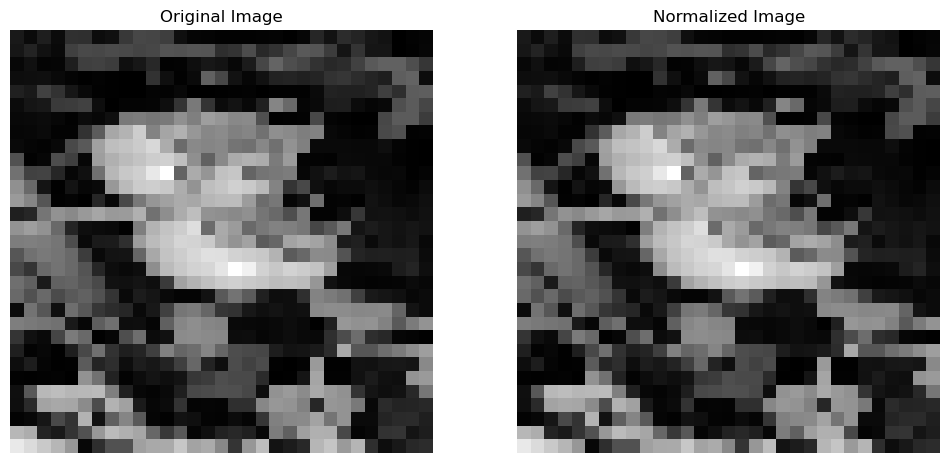

In [143]:
for image, label in res31luminosity_train_data.unbatch().take(1):
    original_image = image.numpy()
    normalized_image, label = standardize_image(image, label, mean_res31, stddev_res31)
    normalized_image = normalized_image.numpy()

    # Plotting the original and normalized images
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.imshow(original_image, cmap = "gray")
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(normalized_image, cmap = "gray")
    plt.title("Normalized Image")
    plt.axis('off')

    plt.show()

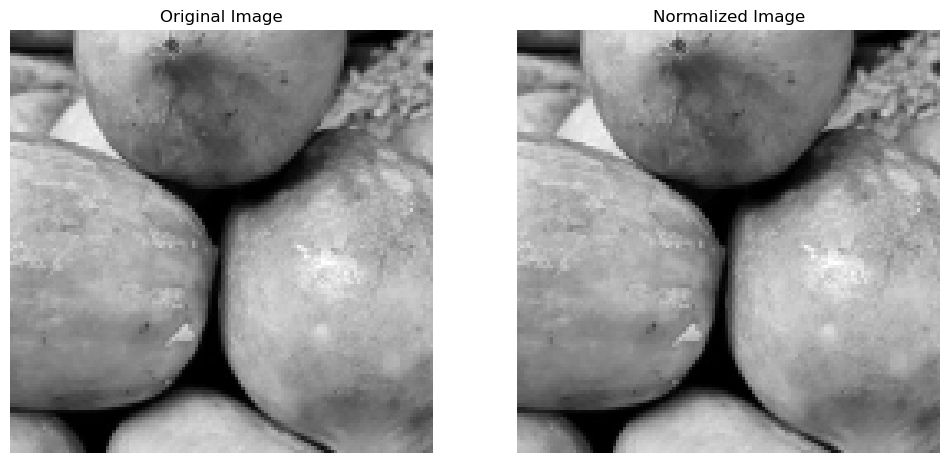

In [144]:
for image, label in res128luminosity_train_data.unbatch().take(1):
    original_image = image.numpy()
    normalized_image, label = standardize_image(image, label, mean_res31, stddev_res31)
    normalized_image = normalized_image.numpy()

    #plotting the original and normalized images
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.imshow(original_image, cmap = "gray")
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(normalized_image, cmap = "gray")
    plt.title("Normalized Image")
    plt.axis('off')

    plt.show()

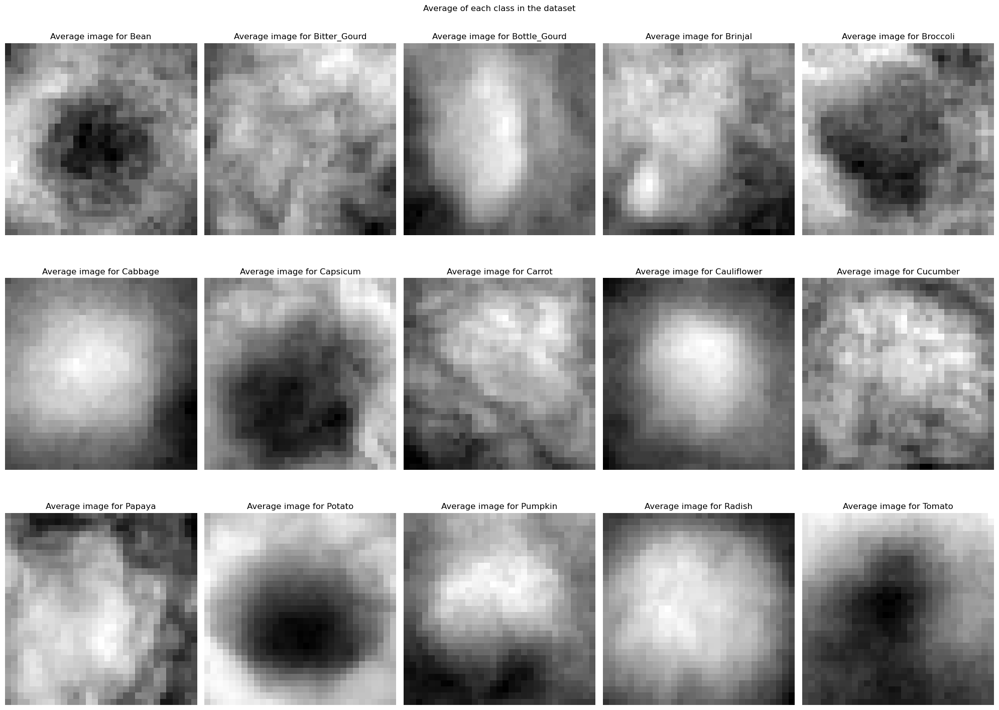

In [145]:
cnnf.average_images_per_class(std_res31_full.unbatch(), class_names)

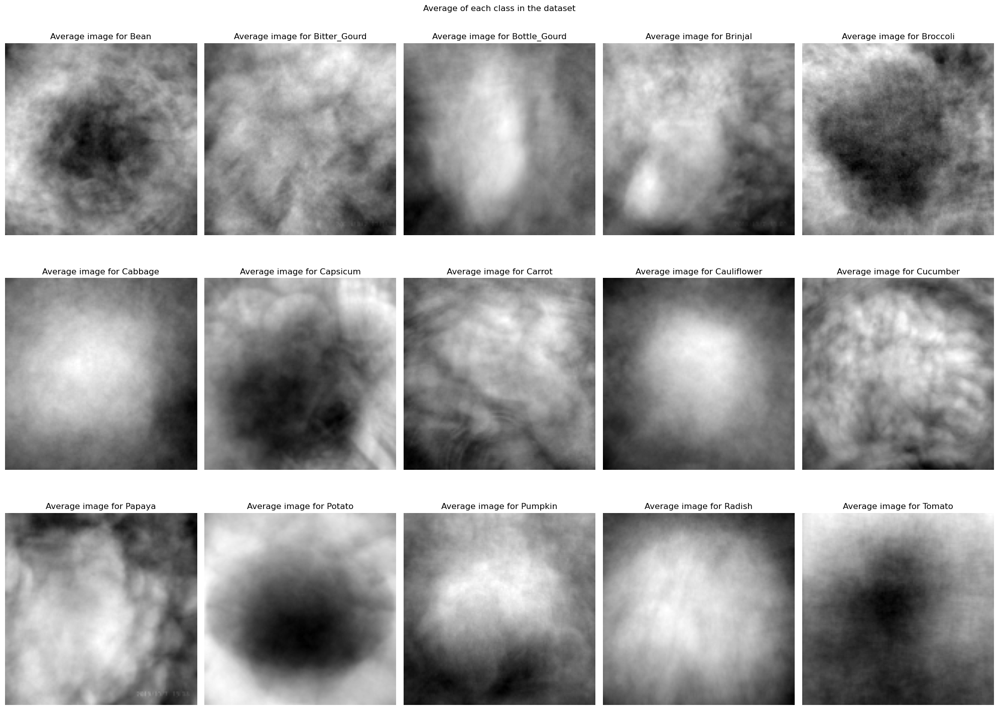

In [146]:
cnnf.average_images_per_class(std_res128_full.unbatch(), class_names)

From the above 4 plots, we can see that there is a slight difference after normalizing the images. The reason for the difference being this small may be due to the original mean already being close to the target of 0.5, hence requiring minimal shift in the pixel's brightness. We can also see that there are some differences in the features between the classes, with some having black centers, and some having whites. Some of the classes also have a "spot" in the middle, while some have the black/white spread through out the image. This tells us that there are potential features for the later models to pick apart, helping it to identify the individual classees.

<hr>
<font size = 5>Initial Modelling</font>
<hr>

Given that we already started using a basic CNN as a baseline model earlier, we shall now move onto using more complicated models for our task. We shall base our more complicated models off of the already established `VGG` and `InceptionNet` architectures, modifying them slightly to fit our use cases.
Furthermore, as these models learn quickly compared to the baseline models we created earlier, we shall increase the patience of our EarlyStopper, to give the models more time to learn.

In [147]:
earlyStopper = EarlyStopping(monitor = 'val_loss', patience = 30)

<font size = 5>What is VGG?</font>
<hr>
VGG, also known as VGGNet, is a classical convolutional neural network architecture, and was developed to increase the depth of CNNs to enhance it's performance. It stands for *Visual Geometry Group* , and is a standard deep CNN architecture, with multiple layers. Some iterations of VGG include *VGG-16*, and *VGG-19*, which consist of 16 and 19 convolutional layers respectively. It has formed the basis of other well-performing object detection models, and has done better than most other models on ImageNet. A VGG model is typically called "VGG-x", with x representing the number of layers it supports. For our use case, we shall make use of a simplified VGG-13 model, and a lighter version of the VGG-16 model. This is as the model typically accepts 224 x 224 images, but since we are using images of 31 x 31 and 128 x 128 respectively, we shall simplify the models to represent that.
<br>
<br>
A VGG model's architecture typically consists of an Input layer, followed by Convolutional Layers, Hidden Layers, then closing with Fully-Connected layers. A standard VGG-16 model would have 13 Convolutional Layers, and 3 Fully Connected Layers, meaning that it is a relatively extenstive network, with ~138 million trainable parameters. In addition, the number of filters that the model looks at doubles per "block", typically starting at 64, then 128, onto 256, and using 512 in the final layers. The large amount of filters typically allow it to identify a large amount of features, however, this comes with the downside of making it a large network, and thus taking a large amount of time to train.

![0 6VP81rFoLWp10FcG.jpg](<attachment:0 6VP81rFoLWp10FcG.jpg>)
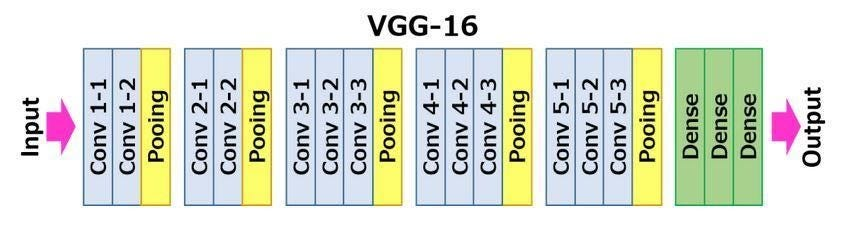

In [148]:
vgg16Model = VGG16(
    include_top=True,
    weights='imagenet',
    input_tensor=None,
    input_shape=None,
    pooling=None,
    classes=1000,
    classifier_activation='softmax'
)

In [149]:
vgg16Model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_15 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

From the above, we can see that the example VGG16 model has 138 million parameters, with a `224 x 224` input layer. We shall simplify the model, and reduce the number of parameters to make it suitable for our `31 x 31` and `128 x 128` input images.

<font size = 5>What is InceptionNet?</font>
<hr>
InceptionNet V3, also known as Inception V3, is an advanced convolutional neural network (CNN) architecture, notable for its innovative use of "Inception modules". It is a significant evolution of the original InceptionNet, or GoogLeNet, designed to increase the efficiency and accuracy of deep CNNs. This model is especially adept at reducing computational burden while enhancing the network's ability to learn rich and complex features from images. InceptionNet V3 features a complex arrangement of convolutional layers, pooling layers, and fully connected layers, alongside the characteristic Inception modules which involve parallel convolutions of different sizes. 
<br>

The architecture of InceptionNet V3 includes an input layer, followed by a series of Inception modules, auxiliary classifiers for training, and ends with fully connected layers. This structure allows it to manage a more diverse range of filters simultaneously, enhancing its capability to recognize a wide array of features in images. While it maintains a high level of accuracy, Inception V3 is also optimized for efficient computation, making it a robust choice for challenging image recognition tasks. The model is known for its performance on ImageNet and other benchmark datasets, demonstrating its effectiveness in complex object detection and classification scenarios.
<br>

A typical InceptionNet V3 architecture consists of grid size reduction modules bewteen each version of "Inception Module". For our use case, we shall remove these grid-size reductions, given the already small size of our images, at `128 x 128`, and `31 x 31`, compared to the original `299 x 299` which InceptionNet V3 was created and optimized for.

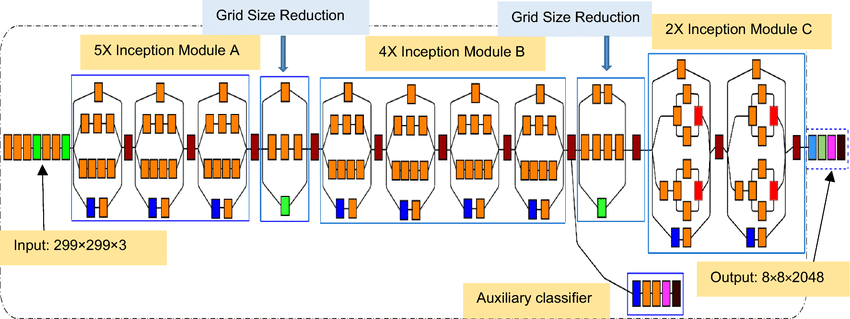

In [150]:
inceptionModel = tf.keras.applications.InceptionV3(
    include_top=True,
    weights="imagenet",
    input_tensor=None,
    input_shape=None,
    pooling=None,
    classes=1000,
    classifier_activation="softmax",
)

inceptionModel.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_16 (InputLayer)          [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_199 (Conv2D)            (None, 149, 149, 32  864         ['input_16[0][0]']               
                                )                                                                 
                                                                                                  
 batch_normalization_157 (Batch  (None, 149, 149, 32  96         ['conv2d_199[0][0]']             
 Normalization)                 )                                                      

The above summary tells us about the format of InceptionNet v3, showing how it uses BatchNormalization and Activation layers after each convolutional layer. We shall take note of this, and apply it later on. In addition, we shall also simplify the InceptionNet model, given that it was optimized for `299 x 299` images, and not the `128 x 128` and `31 x 31` images of our dataset.

<hr>
<font size = 5>Initial Modelling (31 x 31)</font>
<hr>

In [151]:
def vgg_block(n_conv, n_filter, pooling = True):
    block = Sequential()
    for _ in range (n_conv):
        block.add(Conv2D(n_filter, kernel_size=3, padding='same', activation='relu'))
        block.add(BatchNormalization())
        block.add(ReLU())
    if pooling:
        block.add(MaxPooling2D(pool_size=2, strides=2))
    return block

Here, we make a simpler model based on the VGG architecture. We make use of 10 Convolutional Layers, and 3 Fully Connected layers, making it a VGG-13 model. In addition, instead of using a 1000 channel softmax layer, we use a 15 channel softmax layer to match the output of our dataset.

Epoch 1/150
283/283 [==============================] - 9s 25ms/step - loss: 2.4111 - accuracy: 0.2172 - val_loss: 2.9013 - val_accuracy: 0.0813
Epoch 2/150
283/283 [==============================] - 7s 25ms/step - loss: 1.7566 - accuracy: 0.4350 - val_loss: 1.9467 - val_accuracy: 0.3463
Epoch 3/150
283/283 [==============================] - 7s 24ms/step - loss: 1.3811 - accuracy: 0.5624 - val_loss: 1.5058 - val_accuracy: 0.5510
Epoch 4/150
283/283 [==============================] - 8s 26ms/step - loss: 1.0904 - accuracy: 0.6615 - val_loss: 1.4079 - val_accuracy: 0.5523
Epoch 5/150
283/283 [==============================] - 7s 25ms/step - loss: 0.8906 - accuracy: 0.7370 - val_loss: 1.1108 - val_accuracy: 0.6773
Epoch 6/150
283/283 [==============================] - 7s 24ms/step - loss: 0.7268 - accuracy: 0.7836 - val_loss: 1.1410 - val_accuracy: 0.6817
Epoch 7/150
283/283 [==============================] - 8s 25ms/step - loss: 0.5670 - accuracy: 0.8365 - val_loss: 0.7813 - val_accuracy:

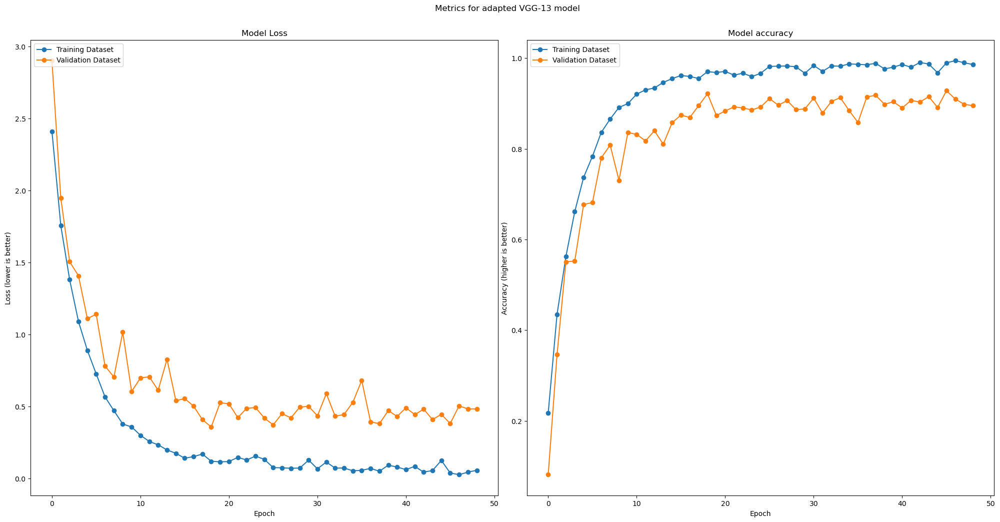

In [152]:
res31_vggmodel = Sequential()
res31_vggmodel.add(Input(shape = (31, 31, 1)))
res31_vggmodel.add(vgg_block(2, 32))
res31_vggmodel.add(vgg_block(2, 64))
res31_vggmodel.add(vgg_block(3, 128))
res31_vggmodel.add(vgg_block(3, 256))
res31_vggmodel.add(Flatten())
res31_vggmodel.add(Dense(4096, activation = "relu"))
res31_vggmodel.add(Dense(4096, activation = "relu"))
res31_vggmodel.add(ActivityRegularization(l1 = 0.0001, l2 = 0.0001))
res31_vggmodel.add(Dense(num_classes, activation = "softmax"))
res31_vggmodel.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

history = res31_vggmodel.fit(std_res31_train, validation_data = std_res31_validation, epochs = 150, callbacks = earlyStopper)
cnnf.model_metric_graph(history, res31_vggmodel, std_res31_validation, name = "adapted VGG-13", class_names = class_names)


In [153]:
res31_vggmodel.summary()

Model: "sequential_90"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_91 (Sequential)  (None, 15, 15, 32)        9824      
                                                                 
 sequential_92 (Sequential)  (None, 7, 7, 64)          55936     
                                                                 
 sequential_93 (Sequential)  (None, 3, 3, 128)         370560    
                                                                 
 sequential_94 (Sequential)  (None, 1, 1, 256)         1478400   
                                                                 
 flatten_19 (Flatten)        (None, 256)               0         
                                                                 
 dense_55 (Dense)            (None, 4096)              1052672   
                                                                 
 dense_56 (Dense)            (None, 4096)            

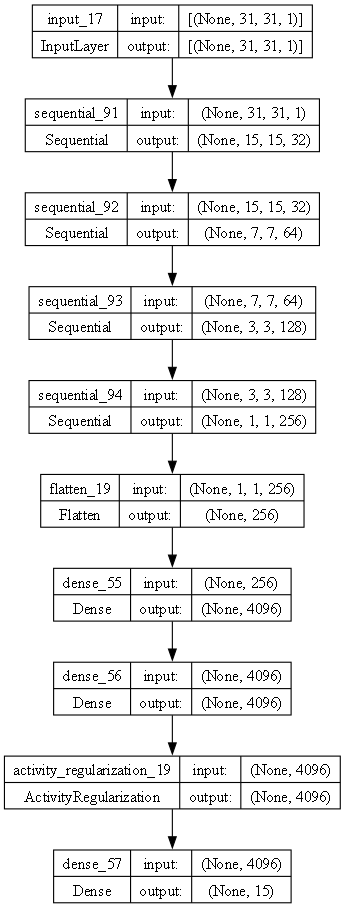

In [154]:
tf.keras.utils.plot_model(res31_vggmodel, show_shapes=True, dpi=80)

From the above, we can see that the VGG architecture performs quite well on our dataset. Now we shall try to create a InceptionNet model, and define the Inception Modules as well.

Defining "Inception Modules" for use later.

"inceptionBlock1" follows this architecture:

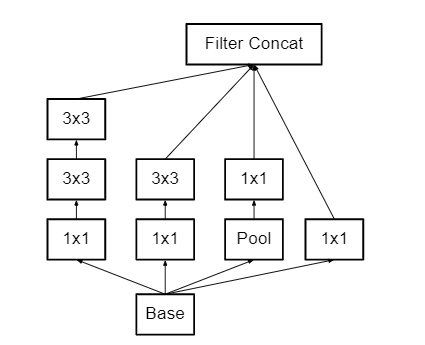

In [155]:
class inceptionBlock1(Layer):
    def __init__(self, num_filters, **kwargs):
        super(inceptionBlock1, self).__init__(**kwargs)
        self.num_filters = num_filters

    def build(self, input_shape):
        self.tower_1_conv1 = Conv2D(self.num_filters, (1, 1), padding='same', activation='relu')
        self.tower_1_conv2 = Conv2D(self.num_filters, (3, 3), padding='same', activation='relu')
        self.tower_1_conv3 = Conv2D(self.num_filters, (3, 3), padding='same', activation='relu')

        self.tower_2_conv1 = Conv2D(self.num_filters, (1, 1), padding='same', activation='relu')
        self.tower_2_conv2 = Conv2D(self.num_filters, (3, 3), padding='same', activation='relu')

        self.tower_3_pool = AveragePooling2D((3, 3), strides=(1, 1), padding='same')
        self.tower_3_conv1 = Conv2D(self.num_filters, (1, 1), padding='same', activation='relu')

        self.tower_4_conv1 = Conv2D(self.num_filters, (1, 1), padding='same', activation='relu')

    def call(self, inputs):
        tower_1 = self.tower_1_conv1(inputs)
        tower_1 = self.tower_1_conv2(tower_1)
        tower_1 = self.tower_1_conv3(tower_1)

        tower_2 = self.tower_2_conv1(inputs)
        tower_2 = self.tower_2_conv2(tower_2)

        tower_3 = self.tower_3_pool(inputs)
        tower_3 = self.tower_3_conv1(tower_3)

        tower_4 = self.tower_4_conv1(inputs)

        output = concatenate([tower_1, tower_2, tower_3, tower_4], axis=3)
        return output

"inceptionBlock2" follows this architecture:

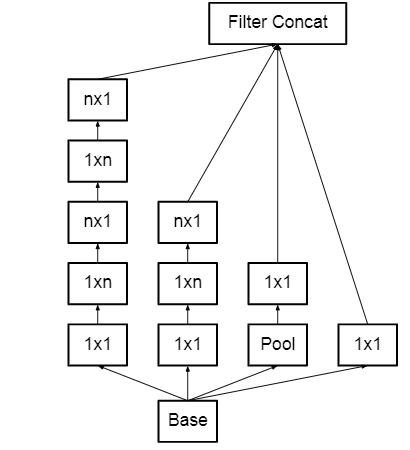

note: for our use, n shall be set at 3, representing a 3 x 3 factorized convolution.

In [156]:
class inceptionBlock2(Layer):
    def __init__(self, num_filters, n, **kwargs):
        super(inceptionBlock2, self).__init__(**kwargs)
        self.num_filters = num_filters
        self.n = n

    def build(self, input_shape):
        self.tower_1_conv1 = Conv2D(self.num_filters, (1, 1), padding='same', activation='relu')
        self.tower_1_conv2 = Conv2D(self.num_filters, (1, self.n), padding='same', activation='relu')
        self.tower_1_conv3 = Conv2D(self.num_filters, (self.n, 1), padding='same', activation='relu')
        self.tower_1_conv4 = Conv2D(self.num_filters, (1, self.n), padding='same', activation='relu')
        self.tower_1_conv5 = Conv2D(self.num_filters, (self.n, 1), padding='same', activation='relu')

        self.tower_2_conv1 = Conv2D(self.num_filters, (1, 1), padding='same', activation='relu')
        self.tower_2_conv2 = Conv2D(self.num_filters, (1, self.n), padding='same', activation='relu')
        self.tower_2_conv3 = Conv2D(self.num_filters, (self.n, 1), padding='same', activation='relu')

        self.tower_3_pool = AveragePooling2D((3, 3), strides=(1, 1), padding='same')
        self.tower_3_conv1 = Conv2D(self.num_filters, (1, 1), padding='same', activation='relu')

        self.tower_4_conv1 = Conv2D(self.num_filters, (1, 1), padding='same', activation='relu')


    def call(self, inputs):
        tower_1 = self.tower_1_conv1(inputs)
        tower_1 = self.tower_1_conv2(tower_1)
        tower_1 = self.tower_1_conv3(tower_1)
        tower_1 = self.tower_1_conv4(tower_1)
        tower_1 = self.tower_1_conv5(tower_1)

        tower_2 = self.tower_2_conv1(inputs)
        tower_2 = self.tower_2_conv2(tower_2)
        tower_2 = self.tower_2_conv3(tower_2)

        tower_3 = self.tower_3_pool(inputs)
        tower_3 = self.tower_3_conv1(tower_3)

        tower_4 = self.tower_4_conv1(inputs)

        output = concatenate([tower_1, tower_2, tower_3, tower_4], axis=3)
        return output

"inceptionBlock3" follows this architecture:

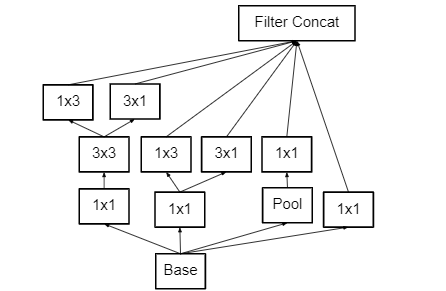

In [157]:
class inceptionBlock3(Layer):
    def __init__(self, num_filters, **kwargs):
        super(inceptionBlock3, self).__init__(**kwargs)
        self.num_filters = num_filters

    def build(self, input_shape):
        self.branch1_conv1 = Conv2D(self.num_filters, (1, 1), padding='same', activation='relu')

        self.branch2_conv1 = Conv2D(self.num_filters, (1, 1), padding='same', activation='relu')
        self.branch2_conv2 = Conv2D(self.num_filters, (1, 3), padding='same', activation='relu')
        self.branch2_conv3 = Conv2D(self.num_filters, (3, 1), padding='same', activation='relu')

        self.branch3_conv1 = Conv2D(self.num_filters, (1, 1), padding='same', activation='relu')
        self.branch3_conv2 = Conv2D(self.num_filters, (3, 3), padding='same', activation='relu')
        self.branch3_conv3 = Conv2D(self.num_filters, (1, 3), padding='same', activation='relu')
        self.branch3_conv4 = Conv2D(self.num_filters, (3, 1), padding='same', activation='relu')

        self.branch4_pool = AveragePooling2D((3, 3), strides=(1, 1), padding='same')
        self.branch4_conv1 = Conv2D(self.num_filters, (1, 1), padding='same', activation='relu')

    def call(self, inputs):
        branch1 = self.branch1_conv1(inputs)

        branch2 = self.branch2_conv1(inputs)
        branch2_1x3 = self.branch2_conv2(branch2)
        branch2_3x1 = self.branch2_conv3(branch2)

        branch3 = self.branch3_conv1(inputs)
        branch3 = self.branch3_conv2(branch3)
        branch3_1x3 = self.branch3_conv3(branch3)
        branch3_3x1 = self.branch3_conv4(branch3)

        branch4 = self.branch4_pool(inputs)
        branch4 = self.branch4_conv1(branch4)

        output = concatenate([branch1, branch2_1x3, branch2_3x1, branch3_1x3, branch3_3x1, branch4], axis=-1)
        return output


Here, we define a simpler version of the InceptionNet v3 model. Instead of using a inception block layout of *3-5-2*, we shall use a simple layour of *2-3-1*. We also remove two more convolutional layers to simplify it further, but add a regularization layer to stabilize the model.

Epoch 1/150


283/283 [==============================] - 20s 49ms/step - loss: 2.5695 - accuracy: 0.1500 - val_loss: 2.5545 - val_accuracy: 0.1227
Epoch 2/150
283/283 [==============================] - 13s 46ms/step - loss: 2.1079 - accuracy: 0.3210 - val_loss: 2.1597 - val_accuracy: 0.3043
Epoch 3/150
283/283 [==============================] - 13s 47ms/step - loss: 1.7902 - accuracy: 0.4403 - val_loss: 3.3991 - val_accuracy: 0.2017
Epoch 4/150
283/283 [==============================] - 14s 48ms/step - loss: 1.5317 - accuracy: 0.5246 - val_loss: 2.6475 - val_accuracy: 0.3013
Epoch 5/150
283/283 [==============================] - 14s 48ms/step - loss: 1.3162 - accuracy: 0.5961 - val_loss: 1.2645 - val_accuracy: 0.6080
Epoch 6/150
283/283 [==============================] - 13s 46ms/step - loss: 1.1083 - accuracy: 0.6577 - val_loss: 1.2395 - val_accuracy: 0.6470
Epoch 7/150
283/283 [==============================] - 13s 46ms/step - loss: 0.9549 - accuracy: 0.7119 - val_loss: 2.3906 - val_accuracy: 0.51

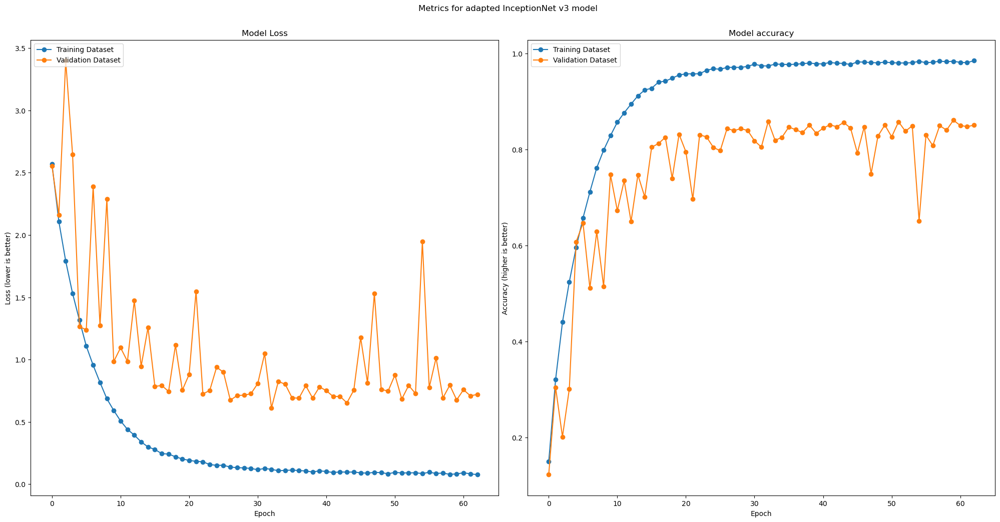

In [158]:
res31_inceptionmodel = Sequential()
res31_inceptionmodel.add(Conv2D(64, kernel_size = (3,3), strides = (2,1), padding = "same", activation = "relu"))
res31_inceptionmodel.add(Conv2D(64, kernel_size = (3,3), strides = (1,1), padding = "valid", activation = "relu"))
res31_inceptionmodel.add(MaxPooling2D((2,2)))
res31_inceptionmodel.add(Conv2D(64, kernel_size = (3,3), strides = (1,1), padding = "same", activation = "relu"))
res31_inceptionmodel.add(Conv2D(64, kernel_size = (3,3), strides = (1,1), padding = "same", activation = "relu"))
res31_inceptionmodel.add(inceptionBlock1(64))
res31_inceptionmodel.add(inceptionBlock1(64))
res31_inceptionmodel.add(inceptionBlock2(num_filters = 64, n = 3))
res31_inceptionmodel.add(inceptionBlock2(num_filters = 64, n = 3))
res31_inceptionmodel.add(inceptionBlock2(num_filters = 64, n = 3))
res31_inceptionmodel.add(inceptionBlock3(num_filters = 64))
res31_inceptionmodel.add(AveragePooling2D())
res31_inceptionmodel.add(Dropout(0.2))
res31_inceptionmodel.add(Dense(2048, activation = "relu"))
res31_inceptionmodel.add(ActivityRegularization(l1 = 0.0005, l2 = 0.0002))
res31_inceptionmodel.add(Flatten()) #added to allow model to work 
res31_inceptionmodel.add(Dense(num_classes, activation = "softmax"))
res31_inceptionmodel.compile(optimizer='rmsprop', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

history = res31_inceptionmodel.fit(std_res31_train, validation_data = std_res31_validation, epochs = 150, callbacks = earlyStopper)
cnnf.model_metric_graph(history, res31_inceptionmodel, std_res31_validation, name = "adapted InceptionNet v3", class_names = class_names)

In [159]:
res31_inceptionmodel.summary()

Model: "sequential_95"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_303 (Conv2D)         (None, 16, 31, 64)        640       
                                                                 
 conv2d_304 (Conv2D)         (None, 14, 29, 64)        36928     
                                                                 
 max_pooling2d_89 (MaxPoolin  (None, 7, 14, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_305 (Conv2D)         (None, 7, 14, 64)         36928     
                                                                 
 conv2d_306 (Conv2D)         (None, 7, 14, 64)         36928     
                                                                 
 inception_block1_20 (incept  (None, 7, 14, 256)       127424    
 ionBlock1)                                          

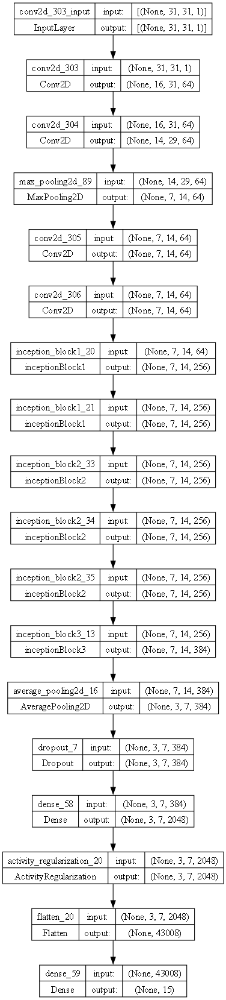

In [160]:
tf.keras.utils.plot_model(res31_inceptionmodel, show_shapes=True, dpi=80)

94/94 [==============================] - 1s 9ms/step - loss: 1.2177 - accuracy: 0.6267


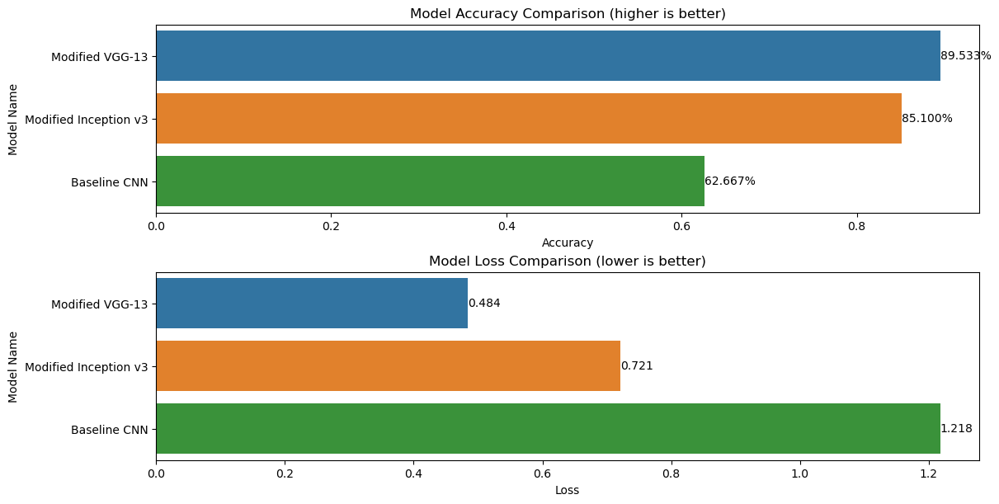

In [161]:
finalres31_model_list = [res31_vggmodel, res31_inceptionmodel, baseline31luminosity_model]
finalres31_data_list = [std_res31_validation, std_res31_validation, res31luminosity_validation_data]
name_list = ["Modified VGG-13", "Modified Inception v3", "Baseline CNN"]
cnnf.model_comparison(finalres31_model_list, finalres31_data_list, name_list)

From the above, we can see that the VGG-13 model performs the best, better than the baseline CNN model we used, and much better than the InceptionNet v3 model that we attempted to use. Hence, from this, we shall tune the VGG-13 model, and improve it for the final model.

<hr>
<font size = 5>Initial Modelling (128 x 128)</font>
<hr>

Here, we attempt to make a model for our data, based off of the VGG architecture. For this model, we make use of 13 convolutional layers, and 3 Fully Connected (Dense) layers, making it a VGG-16 model. In addition, instead of using a 1000 channel softmax layer, we use a 15 channel softmax layer to match the output of our dataset.

Epoch 1/150
283/283 [==============================] - 31s 104ms/step - loss: 2.3772 - accuracy: 0.2537 - val_loss: 3.4935 - val_accuracy: 0.0663
Epoch 2/150
283/283 [==============================] - 29s 102ms/step - loss: 1.5532 - accuracy: 0.4900 - val_loss: 2.0382 - val_accuracy: 0.3340
Epoch 3/150
283/283 [==============================] - 29s 102ms/step - loss: 1.2367 - accuracy: 0.6079 - val_loss: 2.6715 - val_accuracy: 0.3583
Epoch 4/150
283/283 [==============================] - 29s 102ms/step - loss: 0.9627 - accuracy: 0.6995 - val_loss: 1.1481 - val_accuracy: 0.6597
Epoch 5/150
283/283 [==============================] - 29s 102ms/step - loss: 0.7828 - accuracy: 0.7605 - val_loss: 2.3542 - val_accuracy: 0.5103
Epoch 6/150
283/283 [==============================] - 29s 102ms/step - loss: 0.6334 - accuracy: 0.8022 - val_loss: 1.2860 - val_accuracy: 0.6233
Epoch 7/150
283/283 [==============================] - 29s 102ms/step - loss: 0.5528 - accuracy: 0.8295 - val_loss: 0.9168 -

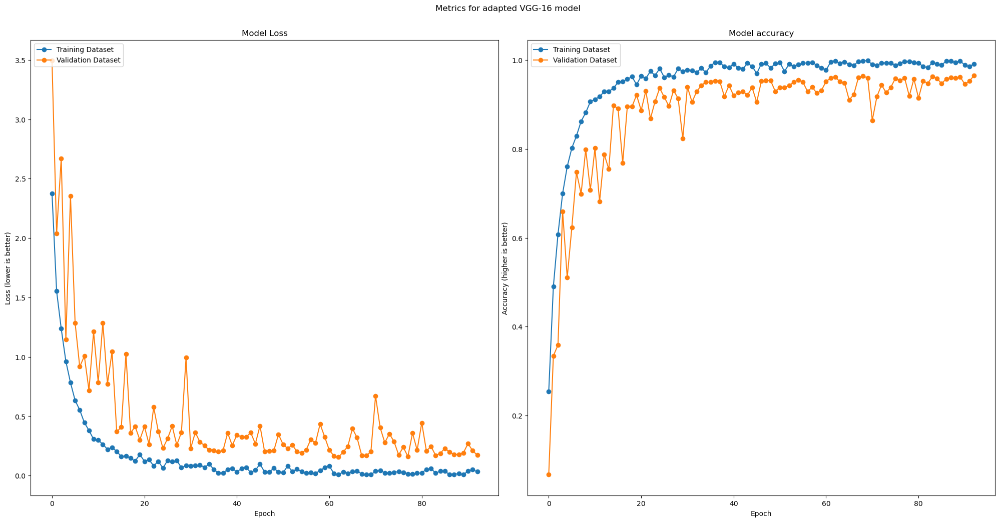

In [162]:
res128_vggmodel = Sequential()
res128_vggmodel.add(Input(shape = (128, 128, 1)))
res128_vggmodel.add(vgg_block(2, 32))
res128_vggmodel.add(vgg_block(2, 64))
res128_vggmodel.add(vgg_block(3, 128))
res128_vggmodel.add(vgg_block(3, 256))
res128_vggmodel.add(vgg_block(3, 256))
res128_vggmodel.add(Dense(4096, activation = "relu"))
res128_vggmodel.add(Dense(4096, activation = "relu"))
res128_vggmodel.add(ActivityRegularization(l1 = 0.00001, l2 = 0.00001))
res128_vggmodel.add(Flatten())
res128_vggmodel.add(Dense(num_classes, activation = "softmax"))
res128_vggmodel.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

history = res128_vggmodel.fit(std_res128_train, validation_data = std_res128_validation, epochs = 150, callbacks = earlyStopper)
cnnf.model_metric_graph(history, res128_vggmodel, std_res128_validation, name = "adapted VGG-16", class_names = class_names)

In [163]:
print(res128_vggmodel.summary())

Model: "sequential_96"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_97 (Sequential)  (None, 64, 64, 32)        9824      
                                                                 
 sequential_98 (Sequential)  (None, 32, 32, 64)        55936     
                                                                 
 sequential_99 (Sequential)  (None, 16, 16, 128)       370560    
                                                                 
 sequential_100 (Sequential)  (None, 8, 8, 256)        1478400   
                                                                 
 sequential_101 (Sequential)  (None, 4, 4, 256)        1773312   
                                                                 
 dense_60 (Dense)            (None, 4, 4, 4096)        1052672   
                                                                 
 dense_61 (Dense)            (None, 4, 4, 4096)      

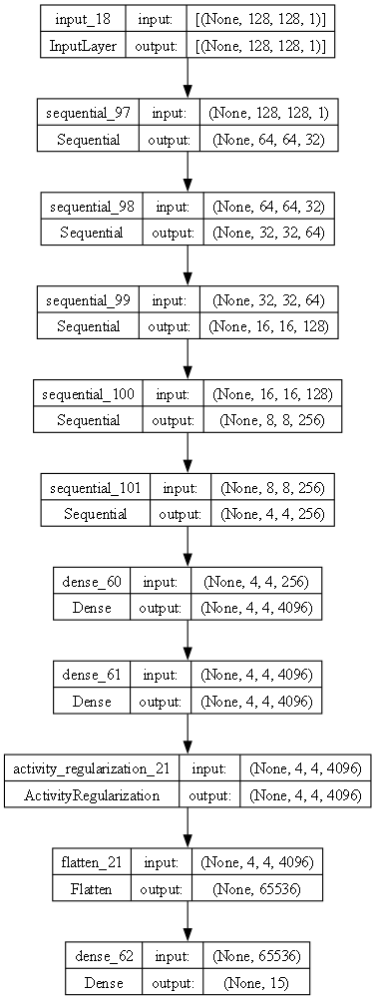

In [164]:
tf.keras.utils.plot_model(res128_vggmodel, show_shapes=True, dpi=80)

Here, we define a simpler version of the InceptionNet v3 model, using a inception block layout of *3-5-2*, We remove one more convolutional layers to simplify it further, but add a regularization layer to stabilize the model. We also implement a dropout layer to prevent combat the model's tendency to overfit.

Epoch 1/150


283/283 [==============================] - 35s 88ms/step - loss: 2.6546 - accuracy: 0.1025 - val_loss: 2.7972 - val_accuracy: 0.0667
Epoch 2/150
283/283 [==============================] - 25s 86ms/step - loss: 2.5269 - accuracy: 0.1485 - val_loss: 2.6198 - val_accuracy: 0.1530
Epoch 3/150
283/283 [==============================] - 25s 86ms/step - loss: 2.2093 - accuracy: 0.2829 - val_loss: 2.1044 - val_accuracy: 0.2797
Epoch 4/150
283/283 [==============================] - 24s 85ms/step - loss: 1.8524 - accuracy: 0.4094 - val_loss: 3.3843 - val_accuracy: 0.2267
Epoch 5/150
283/283 [==============================] - 25s 86ms/step - loss: 1.6113 - accuracy: 0.4988 - val_loss: 2.2433 - val_accuracy: 0.3830
Epoch 6/150
283/283 [==============================] - 35s 121ms/step - loss: 1.3612 - accuracy: 0.5773 - val_loss: 2.5690 - val_accuracy: 0.4683
Epoch 7/150
283/283 [==============================] - 34s 120ms/step - loss: 1.1385 - accuracy: 0.6567 - val_loss: 1.3616 - val_accuracy: 0.

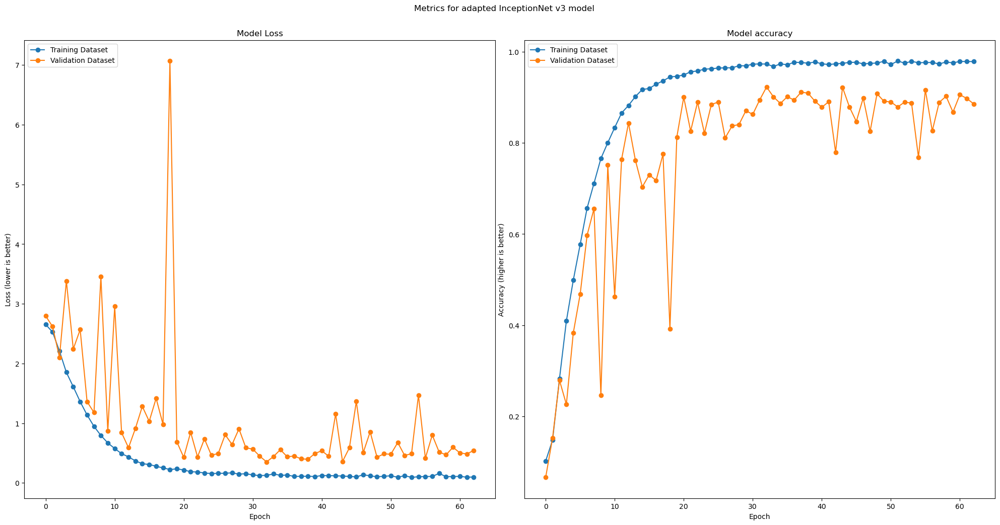

In [167]:
res128_inceptionmodel = Sequential()
res128_inceptionmodel.add(Conv2D(64, kernel_size = (3,3), strides = 2, padding = "same", activation = "relu"))
res128_inceptionmodel.add(Conv2D(64, kernel_size = (3,3), strides = 1, padding = "same", activation = "relu"))
res128_inceptionmodel.add(MaxPooling2D((2,2)))
res128_inceptionmodel.add(Conv2D(64, kernel_size = (3,3), strides = 1, padding = "same", activation = "relu"))
res128_inceptionmodel.add(Conv2D(64, kernel_size = (3,3), strides = 2, padding = "same", activation = "relu"))
res128_inceptionmodel.add(MaxPooling2D((2,2)))
res128_inceptionmodel.add(inceptionBlock1(64))
res128_inceptionmodel.add(inceptionBlock1(64))
res128_inceptionmodel.add(inceptionBlock1(64))
res128_inceptionmodel.add(inceptionBlock2(num_filters = 64, n = 3))
res128_inceptionmodel.add(inceptionBlock2(num_filters = 64, n = 3))
res128_inceptionmodel.add(inceptionBlock2(num_filters = 64, n = 3))
res128_inceptionmodel.add(inceptionBlock2(num_filters = 64, n = 3))
res128_inceptionmodel.add(inceptionBlock2(num_filters = 64, n = 3))
res128_inceptionmodel.add(inceptionBlock3(num_filters = 64))
res128_inceptionmodel.add(inceptionBlock3(num_filters = 64))
res128_inceptionmodel.add(AveragePooling2D((2,2)))
res128_inceptionmodel.add(Dropout(0.1))
res128_inceptionmodel.add(Dense(2048, activation = "relu"))
res128_inceptionmodel.add(ActivityRegularization(l1 = 0.0005, l2 = 0.0002))
res128_inceptionmodel.add(Flatten())
res128_inceptionmodel.add(Dense(num_classes, activation = "softmax"))
res128_inceptionmodel.compile(optimizer='rmsprop', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

history = res128_inceptionmodel.fit(std_res128_train, validation_data = std_res128_validation, epochs = 150, callbacks = earlyStopper)
cnnf.model_metric_graph(history, res128_inceptionmodel, std_res31_validation, name = "adapted InceptionNet v3", class_names = class_names)

In [ ]:
res128_inceptionmodel.summary()

Model: "sequential_72"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_162 (Conv2D)         (None, 64, 64, 64)        640       
                                                                 
 conv2d_163 (Conv2D)         (None, 64, 64, 64)        36928     
                                                                 
 max_pooling2d_66 (MaxPoolin  (None, 32, 32, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_164 (Conv2D)         (None, 32, 32, 64)        36928     
                                                                 
 conv2d_165 (Conv2D)         (None, 16, 16, 64)        36928     
                                                                 
 max_pooling2d_67 (MaxPoolin  (None, 8, 8, 64)         0         
 g2D)                                                

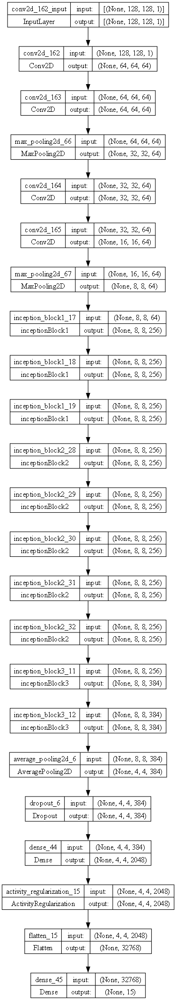

In [ ]:
tf.keras.utils.plot_model(res128_inceptionmodel, show_shapes=True, dpi=80)

94/94 [==============================] - 2s 16ms/step - loss: 1.3337 - accuracy: 0.6287


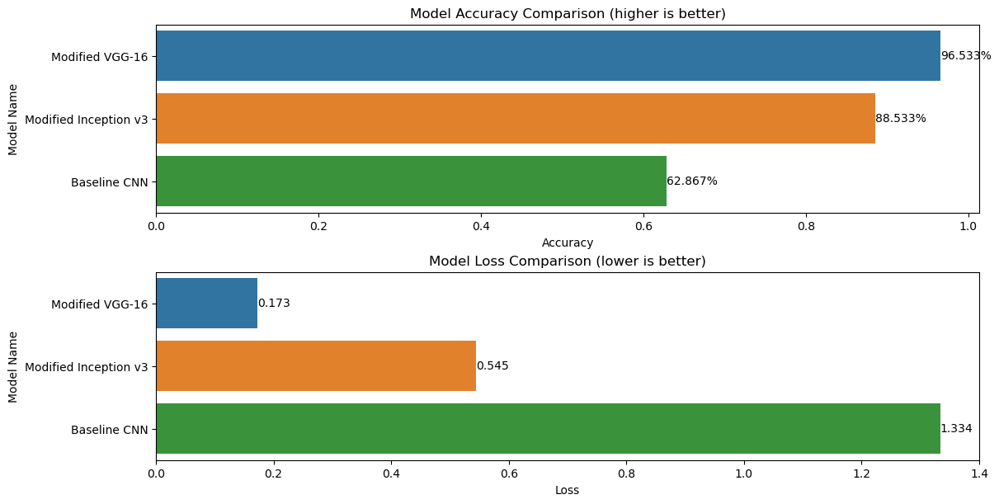

In [168]:
finalres128_model_list = [res128_vggmodel, res128_inceptionmodel, baseline128luminosity_model]
finalres128_data_list = [std_res128_validation, std_res128_validation, res128luminosity_validation_data]
name_list = ["Modified VGG-16", "Modified Inception v3", "Baseline CNN"]
cnnf.model_comparison(finalres128_model_list, finalres128_data_list, name_list)

From the above, we can see that the VGG-16 model performs the best, better than both the baseline and the InceptionNet model that we have created.

<hr>
<font size = 5> Model Improvement (Explanation)</font>
<hr>

To help us further improve the performance of the model, we shall attempt to fix the class imbalance, and hypertune the parameters of the model to allow it to acheive higher accuracies.
Firstly, we shall use augmentation to try to fix the class imbalance. Earlier on, when attempting to create the model, there was a issue where a certain combination of layers and parameters would result in the models predicting only tomatoes (henceforth called Tomato Model). The Tomato Model may have been caused by several factors, one of which being it being the most populous in the dataset. To help the model better predict the less popular classes, we shall augment those classes to give all classes a "fair" chance.

In [13]:
def augment_dataset(dataset, rotation_range=30, zoom_range=0.2, width_shift_range=0.1, height_shift_range=0.1, horizontal_flip=True):
    def augment(image, label):
        if horizontal_flip:
            image = tf.image.random_flip_left_right(image)
        image = tf.image.rot90(image, k=tf.random.uniform(shape=[], minval=0, maxval=4, dtype=tf.int32))
        image = tf.keras.layers.RandomZoom(zoom_range)(image)
        return image, label
    return dataset.map(augment)

aug_res31_train = augment_dataset(std_res31_train)
aug_res128_train = augment_dataset(std_res128_train)

The figure below shows the effect of augmentation on the (31 x 31) dataset.

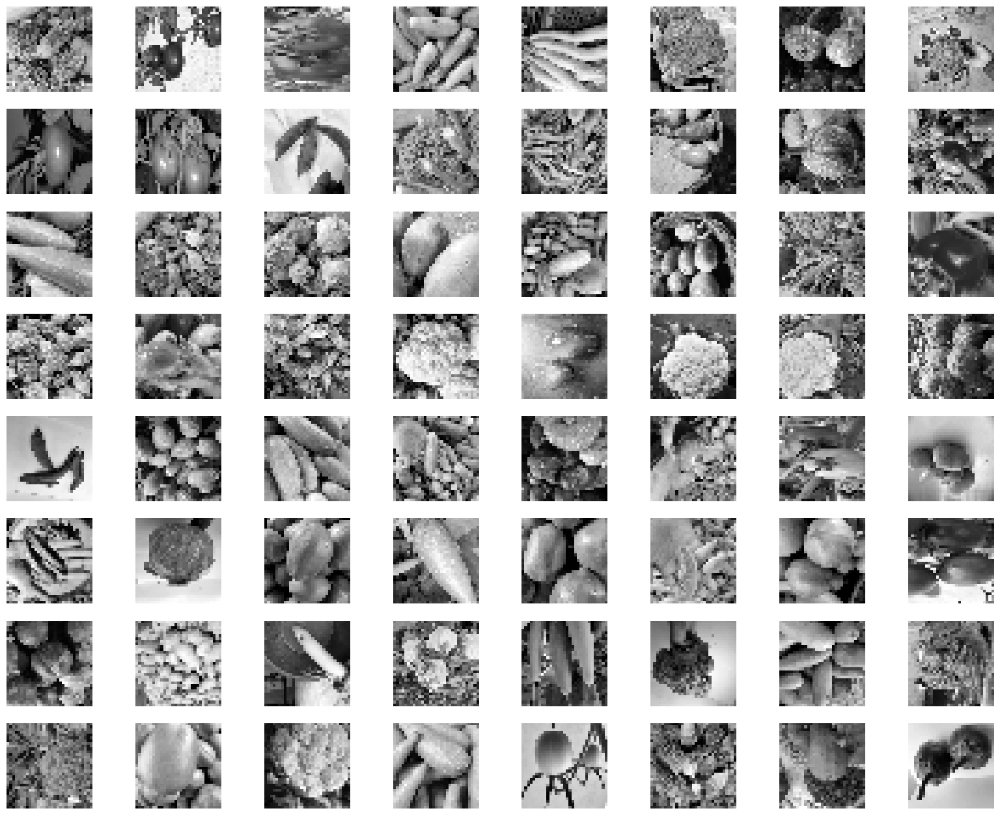

In [170]:
plt.figure(figsize=(20, 16))

for i, (image, _) in enumerate(aug_res31_train.unbatch().take(8 ** 2)):
    plt.subplot(8, 8, i + 1)
    plt.imshow(image.numpy(), cmap = "gray")
    plt.axis("off")
plt.show()

The figure below shows the effect of augmentation on the (128 x 128) dataset.

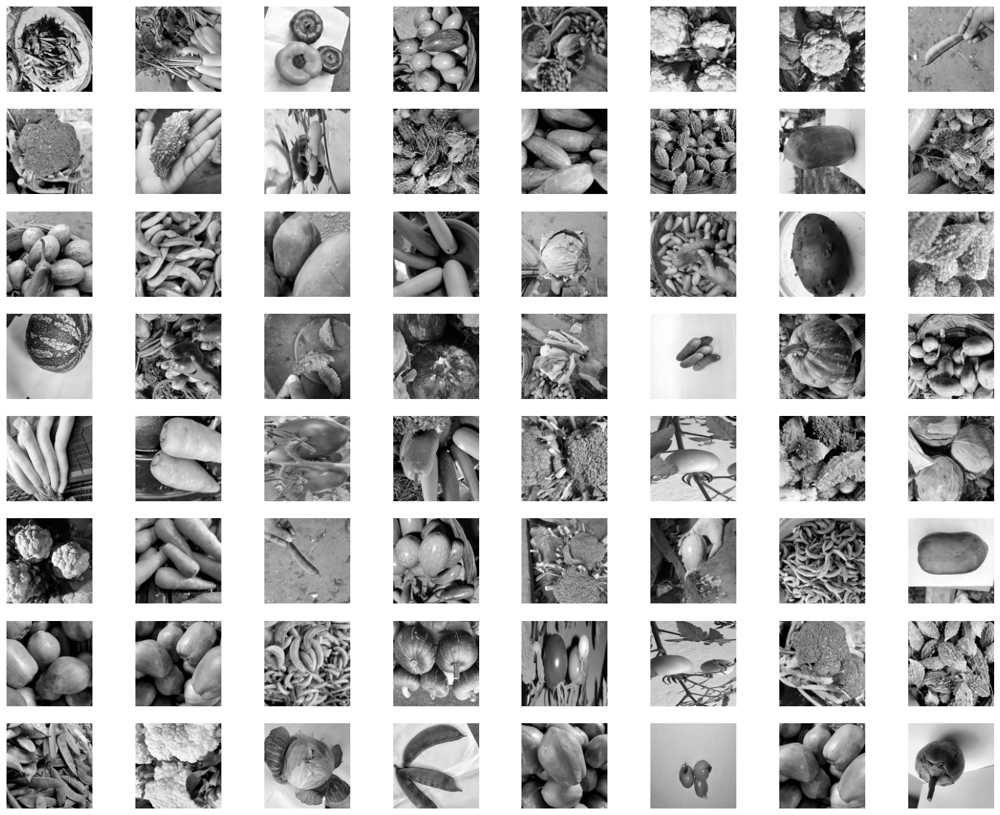

In [171]:
plt.figure(figsize=(20, 16))

for i, (image, _) in enumerate(aug_res128_train.unbatch().take(8 ** 2)):
    plt.subplot(8, 8, i + 1)
    plt.imshow(image.numpy(), cmap = "gray")
    plt.axis("off")
plt.show()

As we observed earlier, the given dataset is severly imbalanced, with some classes being represented more often than others. To help us combat this, we shall attempt to use class weights to promote a more equal representation of all classes. Class Weights does this by assigning different weights to each class during the training phase, so that it the contribution of each class is balanced. It is typically inversely proportional to the class's frequency in the dataset. 

In [17]:
def generate_class_weights(class_series, multi_class=True, one_hot_encoded=False): 
  if multi_class:
    if one_hot_encoded:
      class_series = np.argmax(class_series, axis=1)
  
    class_labels = np.unique(class_series)
    class_weights = compute_class_weight(class_weight='balanced', classes=class_labels, y=class_series)
    return dict(zip(class_labels, class_weights))
  else:
    mlb = None
    if not one_hot_encoded:
      mlb = MultiLabelBinarizer()
      class_series = mlb.fit_transform(class_series)

    n_samples = len(class_series)
    n_classes = len(class_series[0])

    class_count = [0] * n_classes
    for classes in class_series:
        for index in range(n_classes):
            if classes[index] != 0:
                class_count[index] += 1
    
    class_weights = [n_samples / (n_classes * freq) if freq > 0 else 1 for freq in class_count]
    class_labels = range(len(class_weights)) if mlb is None else mlb.classes_
    return dict(zip(class_labels, class_weights))
  
labels = np.array([label.numpy() for _, label in std_res31_train.unbatch()])
class_weights = generate_class_weights(labels)

In [173]:
print(class_weights)

{0: 0.7716239316239316, 1: 0.835925925925926, 2: 1.3647770219198792, 3: 0.693394777265745, 4: 0.8024888888888889, 5: 1.1965540092776674, 6: 1.7147198480531813, 7: 2.3510416666666667, 8: 1.0253265190232823, 9: 0.7412151067323481, 10: 1.0633686690223794, 11: 1.5964633068081344, 12: 0.7393939393939394, 13: 2.4268817204301074, 14: 0.6302268760907505}


Another improvement that can be done to the model is Random Blockout. Random Blockout works by randomly hiding patches in the image, to force the network to seek for other as many other details in the image for object classification. This can be typically done using black pixels, or by filling it with random values. This is typically done to combat overfitting, and bolster accuracy. However, as our VGG architecture(s) both do not overfit to a large extent, we can skip implementing this improvement.

<hr>
<font size = 5>Model Improvement (31 x 31)</font>
<hr>

Now, we shall run the best VGG model layout 3 more times, and with 3 different permutations.
- Class Weights only.
- Augmentation only.
- Both Class Weights and Augmentation applied.
  
Once those models have been trained, we shall compare it to the base model, with none of these improvments applied, so that we can see how it performs relative to each other.

In [174]:
res31_final = Sequential()
res31_final.add(Input(shape = (31, 31, 1)))
res31_final.add(vgg_block(2, 32))
res31_final.add(vgg_block(2, 64))
res31_final.add(vgg_block(3, 128))
res31_final.add(vgg_block(3, 256))
res31_final.add(Flatten())
res31_final.add(Dense(4096, activation = "relu"))
res31_final.add(Dense(4096, activation = "relu"))
res31_final.add(ActivityRegularization(l1 = 0.0001, l2 = 0.0001))
res31_final.add(Dense(num_classes, activation = "softmax"))
res31_final.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [175]:
res31_final_cw = clone_model(res31_final)
res31_final_aug = clone_model(res31_final)
res31_final_cw_aug = clone_model(res31_final)

res31_final_cw.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
res31_final_aug.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
res31_final_cw_aug.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])


Epoch 1/150


283/283 [==============================] - 13s 39ms/step - loss: 2.4930 - accuracy: 0.1689 - val_loss: 3.6244 - val_accuracy: 0.0730
Epoch 2/150
283/283 [==============================] - 12s 39ms/step - loss: 1.8793 - accuracy: 0.3681 - val_loss: 2.0493 - val_accuracy: 0.3847
Epoch 3/150
283/283 [==============================] - 12s 40ms/step - loss: 1.5249 - accuracy: 0.4973 - val_loss: 1.6812 - val_accuracy: 0.4467
Epoch 4/150
283/283 [==============================] - 12s 39ms/step - loss: 1.1718 - accuracy: 0.6142 - val_loss: 1.3203 - val_accuracy: 0.5823
Epoch 5/150
283/283 [==============================] - 12s 40ms/step - loss: 0.8995 - accuracy: 0.7159 - val_loss: 0.9450 - val_accuracy: 0.7200
Epoch 6/150
283/283 [==============================] - 12s 42ms/step - loss: 0.7108 - accuracy: 0.7754 - val_loss: 1.0075 - val_accuracy: 0.7387
Epoch 7/150
283/283 [==============================] - 12s 41ms/step - loss: 0.6154 - accuracy: 0.8141 - val_loss: 0.9768 - val_accuracy: 0.71

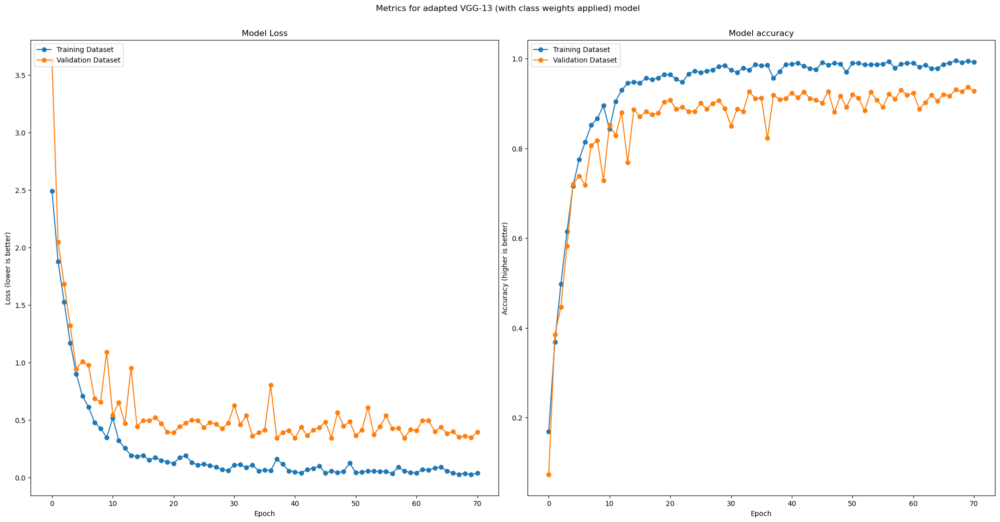

In [176]:
history = res31_final_cw.fit(std_res31_train, validation_data = std_res31_validation, epochs = 150, callbacks = earlyStopper, class_weight = class_weights)
cnnf.model_metric_graph(history, res31_final_cw, std_res31_validation, name = "adapted VGG-13 (with class weights applied)", class_names = class_names)

Epoch 1/150
283/283 [==============================] - 13s 41ms/step - loss: 2.4398 - accuracy: 0.1981 - val_loss: 3.1321 - val_accuracy: 0.0757
Epoch 2/150
283/283 [==============================] - 12s 39ms/step - loss: 1.9682 - accuracy: 0.3367 - val_loss: 3.3598 - val_accuracy: 0.2123
Epoch 3/150
283/283 [==============================] - 12s 40ms/step - loss: 1.7056 - accuracy: 0.4354 - val_loss: 1.7748 - val_accuracy: 0.3940
Epoch 4/150
283/283 [==============================] - 12s 39ms/step - loss: 1.5320 - accuracy: 0.4940 - val_loss: 1.6474 - val_accuracy: 0.4640
Epoch 5/150
283/283 [==============================] - 12s 40ms/step - loss: 1.4093 - accuracy: 0.5395 - val_loss: 1.7738 - val_accuracy: 0.4403
Epoch 6/150
283/283 [==============================] - 11s 39ms/step - loss: 1.2703 - accuracy: 0.5812 - val_loss: 2.0637 - val_accuracy: 0.4260
Epoch 7/150
283/283 [==============================] - 12s 39ms/step - loss: 1.1731 - accuracy: 0.6100 - val_loss: 1.4396 - val_ac

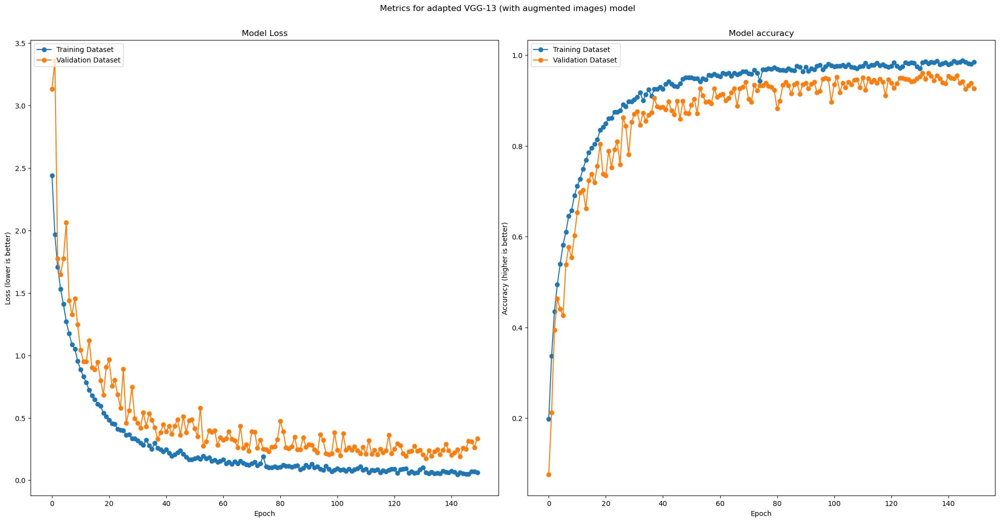

In [177]:
history = res31_final_aug.fit(aug_res31_train, validation_data = std_res31_validation, epochs = 150, callbacks = earlyStopper)
cnnf.model_metric_graph(history, res31_final_aug, std_res31_validation, name = "adapted VGG-13 (with augmented images)", class_names = class_names)

Epoch 1/150
283/283 [==============================] - 13s 40ms/step - loss: 2.5149 - accuracy: 0.1453 - val_loss: 3.0856 - val_accuracy: 0.0737
Epoch 2/150
283/283 [==============================] - 11s 37ms/step - loss: 2.2190 - accuracy: 0.2105 - val_loss: 2.1430 - val_accuracy: 0.2497
Epoch 3/150
283/283 [==============================] - 11s 38ms/step - loss: 2.0479 - accuracy: 0.2962 - val_loss: 2.3048 - val_accuracy: 0.3147
Epoch 4/150
283/283 [==============================] - 11s 37ms/step - loss: 1.8482 - accuracy: 0.3752 - val_loss: 1.9588 - val_accuracy: 0.3890
Epoch 5/150
283/283 [==============================] - 11s 37ms/step - loss: 1.6860 - accuracy: 0.4356 - val_loss: 1.5664 - val_accuracy: 0.5010
Epoch 6/150
283/283 [==============================] - 11s 38ms/step - loss: 1.5316 - accuracy: 0.4940 - val_loss: 1.5872 - val_accuracy: 0.4677
Epoch 7/150
283/283 [==============================] - 11s 37ms/step - loss: 1.4193 - accuracy: 0.5312 - val_loss: 1.9624 - val_ac

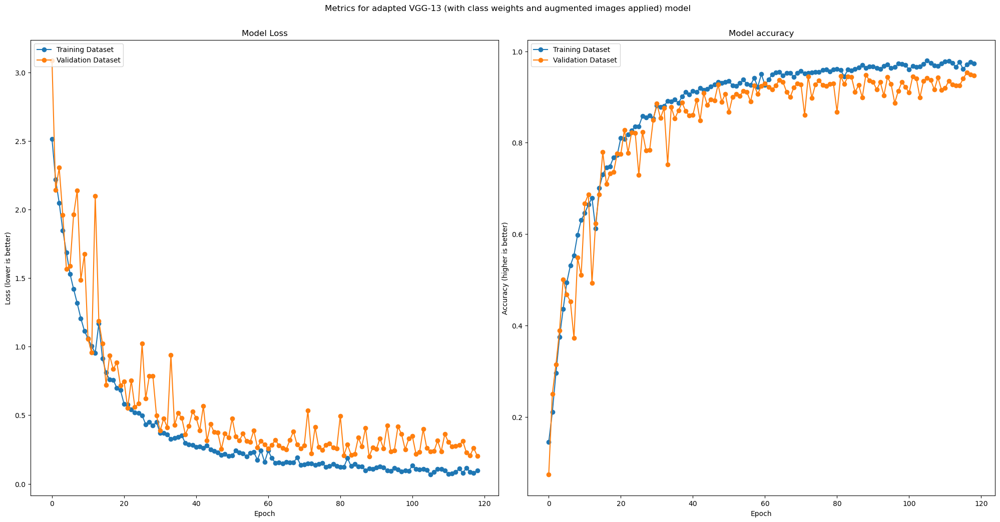

In [178]:
history = res31_final_cw_aug.fit(aug_res31_train, validation_data = std_res31_validation, epochs = 150, callbacks = earlyStopper, class_weight = class_weights)
cnnf.model_metric_graph(history, res31_final_cw_aug, std_res31_validation, name = "adapted VGG-13 (with class weights and augmented images applied)", class_names = class_names)

94/94 [==============================] - 2s 15ms/step - loss: 0.2034 - accuracy: 0.9473


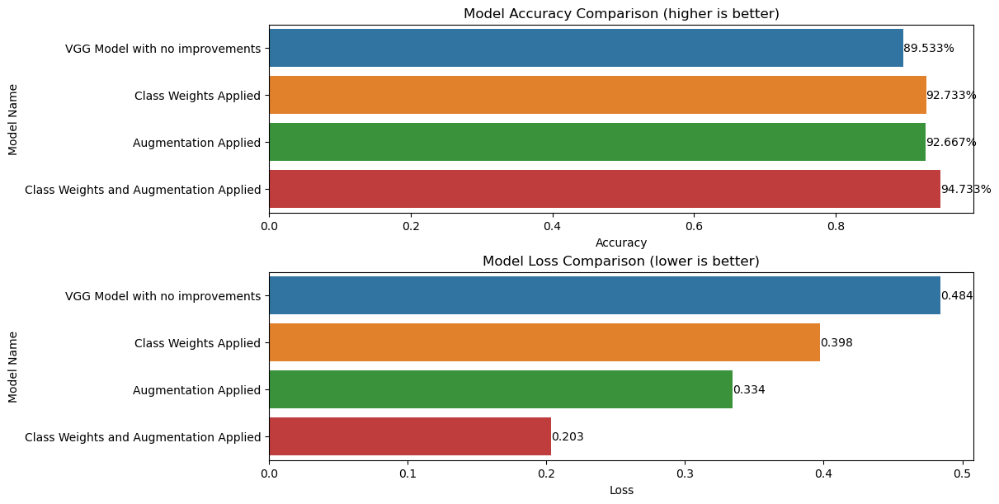

In [187]:
improvement31_model_list = [res31_vggmodel, res31_final_cw, res31_final_aug, res31_final_cw_aug]
improvement31_data_list = [std_res31_validation, std_res31_validation, std_res31_validation, std_res31_validation]
name_list = ["VGG Model with no improvements", "Class Weights Applied", "Augmentation Applied", "Class Weights and Augmentation Applied"]
cnnf.model_comparison(improvement31_model_list, improvement31_data_list, name_list)

From the above, we can see that all of the improvements that we attempted have had a improvement on the model's performance, with the application of Class Weights and Augmentation having the most profound improvement, with accuracy and loss both being the best performing among all the 4 permutations. Hence, we shall now select this model and hypertune it.

From this, we can conclude that augmentation is useful for the 31 x 31 image input size.

We shall save the model that we want to hypertune first, to allow the hypertuning to be seperate from the other models, saving on computational resources.

In [189]:
res31_final_cw_aug.save('res31_best.h5')

<hr>
<font size = 5> Model Improvement (128 x 128)</font>
<hr>

Now, we shall run the best VGG model layout 3 more times, and with 3 different permutations.
- Class Weights only.
- Augmentation only.
- Both Class Weights and Augmentation applied.
  
Once those models have been trained, we shall compare it to the base model, with none of these improvments applied, so that we can see how it performs relative to each other.

In [179]:
res128_final = Sequential()
res128_final.add(Input(shape = (128, 128, 1)))
res128_final.add(vgg_block(2, 32))
res128_final.add(vgg_block(2, 64))
res128_final.add(vgg_block(3, 128))
res128_final.add(vgg_block(3, 256))
res128_final.add(vgg_block(3, 256))
res128_final.add(Dense(4096, activation = "relu"))
res128_final.add(Dense(4096, activation = "relu"))
res128_final.add(ActivityRegularization(l1 = 0.00001, l2 = 0.00001))
res128_final.add(Flatten())
res128_final.add(Dense(num_classes, activation = "softmax"))
res128_final.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [180]:
res128_final_cw = clone_model(res128_final)
res128_final_aug = clone_model(res128_final)
res128_final_cw_aug = clone_model(res128_final)

res128_final_cw.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
res128_final_aug.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
res128_final_cw_aug.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

Epoch 1/150
283/283 [==============================] - 53s 179ms/step - loss: 2.3629 - accuracy: 0.2233 - val_loss: 3.3180 - val_accuracy: 0.0667
Epoch 2/150
283/283 [==============================] - 50s 177ms/step - loss: 1.6899 - accuracy: 0.4466 - val_loss: 2.0270 - val_accuracy: 0.4310
Epoch 3/150
283/283 [==============================] - 51s 179ms/step - loss: 1.3144 - accuracy: 0.5714 - val_loss: 1.5473 - val_accuracy: 0.5450
Epoch 4/150
283/283 [==============================] - 50s 176ms/step - loss: 1.0891 - accuracy: 0.6382 - val_loss: 1.5125 - val_accuracy: 0.5380
Epoch 5/150
283/283 [==============================] - 50s 177ms/step - loss: 0.9119 - accuracy: 0.6942 - val_loss: 1.7319 - val_accuracy: 0.4853
Epoch 6/150
283/283 [==============================] - 50s 176ms/step - loss: 0.7636 - accuracy: 0.7484 - val_loss: 1.0949 - val_accuracy: 0.6930
Epoch 7/150
283/283 [==============================] - 50s 176ms/step - loss: 0.6525 - accuracy: 0.7871 - val_loss: 1.1454 -

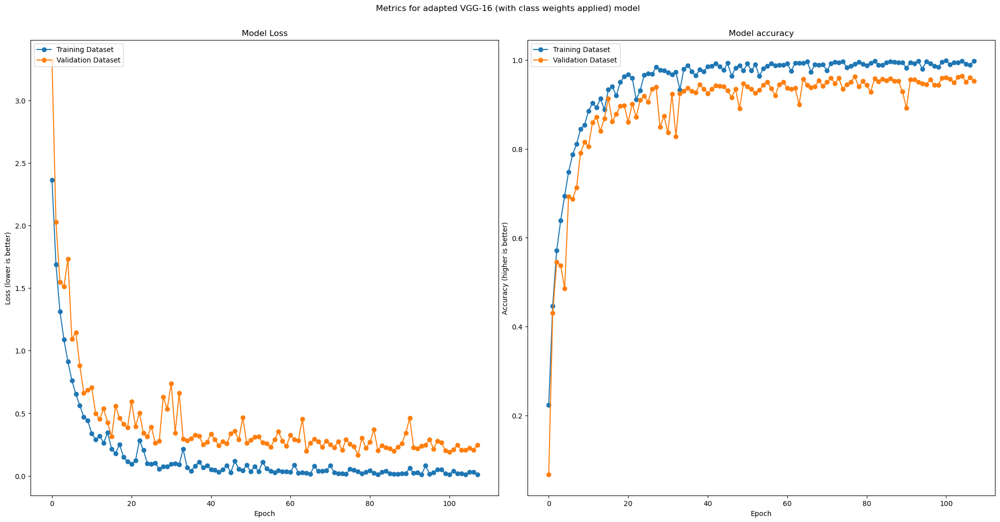

In [181]:
history = res128_final_cw.fit(std_res128_train, validation_data = std_res128_validation, epochs = 150, callbacks = earlyStopper, class_weight = class_weights)
cnnf.model_metric_graph(history, res128_final_cw, std_res31_validation, name = "adapted VGG-16 (with class weights applied)", class_names = class_names)

Epoch 1/150
283/283 [==============================] - 58s 198ms/step - loss: 2.4222 - accuracy: 0.2112 - val_loss: 3.4832 - val_accuracy: 0.0667
Epoch 2/150
283/283 [==============================] - 56s 197ms/step - loss: 1.8777 - accuracy: 0.3677 - val_loss: 2.4124 - val_accuracy: 0.2070
Epoch 3/150
283/283 [==============================] - 56s 196ms/step - loss: 1.6010 - accuracy: 0.4747 - val_loss: 2.6549 - val_accuracy: 0.2847
Epoch 4/150
283/283 [==============================] - 56s 197ms/step - loss: 1.4333 - accuracy: 0.5239 - val_loss: 2.4287 - val_accuracy: 0.3647
Epoch 5/150
283/283 [==============================] - 56s 197ms/step - loss: 1.3196 - accuracy: 0.5670 - val_loss: 1.3495 - val_accuracy: 0.5473
Epoch 6/150
283/283 [==============================] - 56s 197ms/step - loss: 1.1703 - accuracy: 0.6141 - val_loss: 1.7751 - val_accuracy: 0.4633
Epoch 7/150
283/283 [==============================] - 56s 197ms/step - loss: 1.1085 - accuracy: 0.6400 - val_loss: 1.8938 -

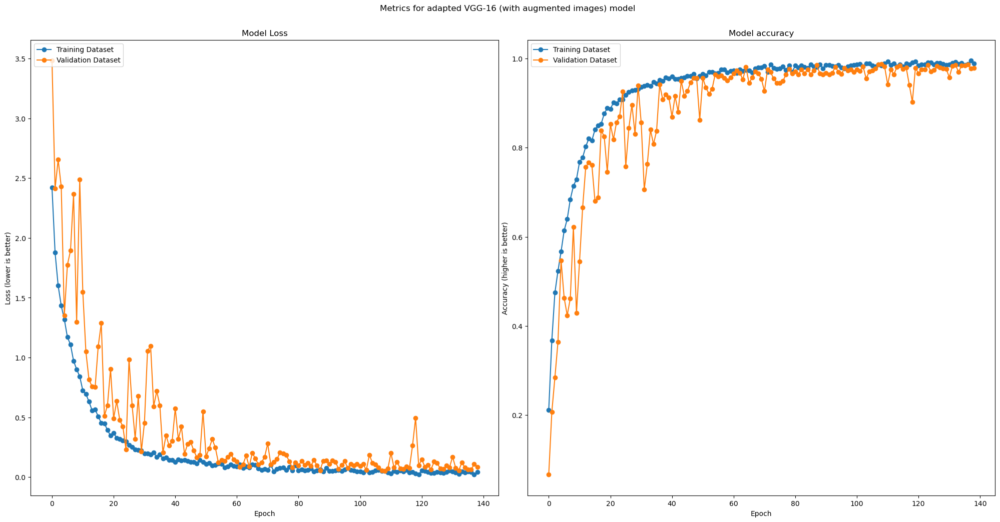

In [182]:
history = res128_final_aug.fit(aug_res128_train, validation_data = std_res128_validation, epochs = 150, callbacks = earlyStopper)
cnnf.model_metric_graph(history, res128_final_aug, std_res31_validation, name = "adapted VGG-16 (with augmented images)", class_names = class_names)

Epoch 1/150
283/283 [==============================] - 52s 176ms/step - loss: 2.5004 - accuracy: 0.1635 - val_loss: 3.5651 - val_accuracy: 0.0773
Epoch 2/150
283/283 [==============================] - 49s 173ms/step - loss: 2.0175 - accuracy: 0.3209 - val_loss: 2.1078 - val_accuracy: 0.2823
Epoch 3/150
283/283 [==============================] - 49s 172ms/step - loss: 1.8039 - accuracy: 0.3949 - val_loss: 3.6867 - val_accuracy: 0.2447
Epoch 4/150
283/283 [==============================] - 49s 171ms/step - loss: 1.7024 - accuracy: 0.4342 - val_loss: 3.4413 - val_accuracy: 0.2903
Epoch 5/150
283/283 [==============================] - 49s 172ms/step - loss: 1.5026 - accuracy: 0.5006 - val_loss: 1.5824 - val_accuracy: 0.4677
Epoch 6/150
283/283 [==============================] - 49s 171ms/step - loss: 1.3714 - accuracy: 0.5439 - val_loss: 2.2896 - val_accuracy: 0.3827
Epoch 7/150
283/283 [==============================] - 49s 172ms/step - loss: 1.2926 - accuracy: 0.5840 - val_loss: 1.4818 -

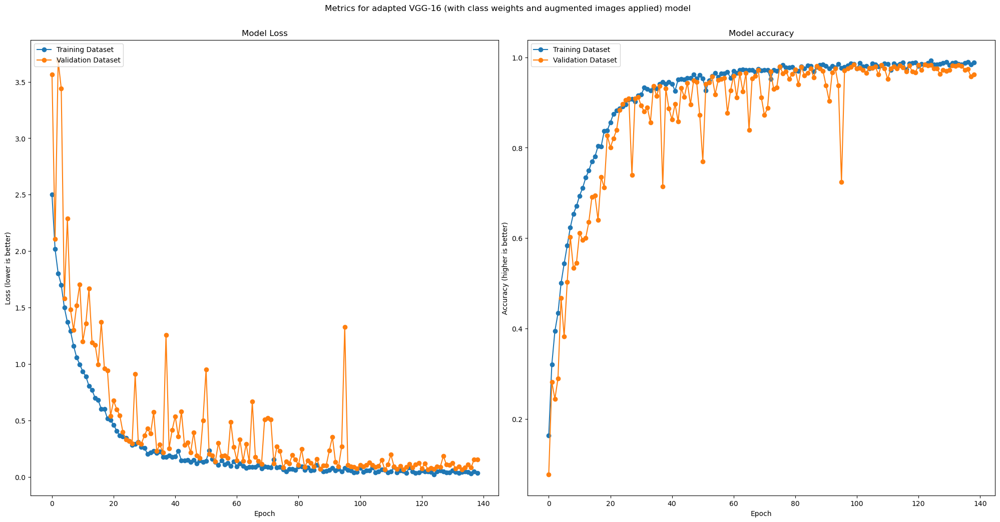

In [183]:
history = res128_final_cw_aug.fit(aug_res128_train, validation_data = std_res128_validation, epochs = 150, callbacks = earlyStopper, class_weight = class_weights)
cnnf.model_metric_graph(history, res128_final_cw_aug, std_res31_validation, name = "adapted VGG-16 (with class weights and augmented images applied)", class_names = class_names)

94/94 [==============================] - 4s 41ms/step - loss: 0.1532 - accuracy: 0.9620


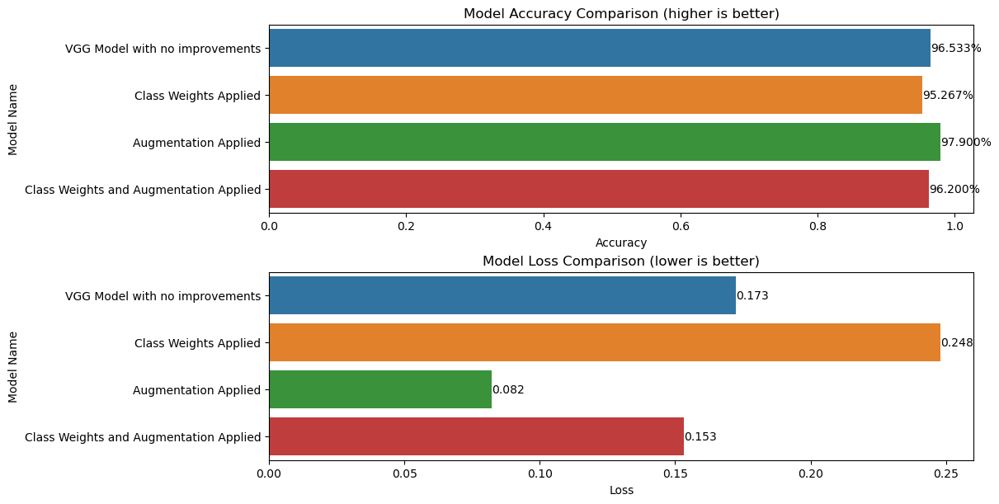

In [188]:
improvement128_model_list = [res128_vggmodel, res128_final_cw, res128_final_aug, res128_final_cw_aug]
improvement128_data_list = [std_res128_validation, std_res128_validation, std_res128_validation, std_res128_validation]
name_list = ["VGG Model with no improvements", "Class Weights Applied", "Augmentation Applied", "Class Weights and Augmentation Applied"]
cnnf.model_comparison(improvement128_model_list, improvement128_data_list, name_list)

From the above, we can see that all of the improvements that we attempted have had a improvement on the model's performance, with the application of Augmentation **only** having the most profound improvement, with accuracy and loss both being the best performing among all the 4 permutations. Hence, we shall now select this model and hypertune it. One interesting observation is that appling class weights actually causes the model to perform worse, with a 43% drop in loss performance.

From this, we can conclude that augmentation is useful for the 128 x 128 image input size.

First, we shall save the model that we want to hypertune, so that we can hypertune seperately, saving on computational resources.

In [190]:
res128_final_aug.save('res128_best.h5')

<hr>
<font size = 5>Model Hypertuning (31 x 31)</font>
<hr>

Now that we have completed the larger steps in model improvement, we shall now take the smaller, final step to allow the model to reach it's peak performance. We shall do this by hypertuning the parameters of the model. For our case, we shall only tune the optimizer, as the loss function is already very well suited for our use case. We shall tune the models using the **Adam**, **SGD**, and **RMSProp** optimizers.

Stochastic Gradient Descent (SGD) is one of the most basic and widely used optimization algorithms in machine learning and deep learning. It's a variant of gradient descent where instead of performing computations on the whole dataset – which can be computationally intensive for large datasets – SGD updates the model's weights using only a single or a few samples at a time. This makes the algorithm much faster and more suitable for large datasets. The formula for SGD is as follows.
$$
w_{t+1} = w_t - \eta \cdot \nabla L(w_t, x_i, y_i)
$$

\begin{aligned}
\text{where} \\
w_{t+1} &\text{ is the updated weight vector at time } t+1, \\
w_t &\text{ is the weight vector at time } t, \\
\eta &\text{ is the learning rate, and} \\
\nabla L(w_t, x_i, y_i) &\text{ is the gradient of the loss function } L \text{ with respect to the weights } w, \text{ evaluated at a randomly chosen data point } (x_i, y_i).
\end{aligned}

RMSProp, short for Root Mean Square Propagation, is an adaptive learning rate method proposed by Geoffrey Hinton. It addresses some of the limitations of SGD, especially in the context of minimizing functions in very high-dimensional spaces. RMSProp adjusts the learning rate for each weight based on the recent magnitudes of the gradients for that weight. This means that the learning rate is reduced for weights that consistently receive high gradients, which helps in faster convergence especially in situations involving oscillations. The formula for RMSProp is as follows.

\begin{aligned}
v_{t+1} &= \beta \cdot v_t + (1 - \beta) \cdot (\nabla L(w_t))^2 \\
w_{t+1} &= w_t - \frac{\eta}{\sqrt{v_{t+1} + \epsilon}} \cdot \nabla L(w_t) \\
\text{where} \\
v_{t+1} &\text{ is the exponentially decaying average of squared gradients} \\
w_{t+1} &\text{ is the updated weight vector at time } t+1 \\
w_t &\text{ is the weight vector at time } t \\
\eta &\text{ is the learning rate} \\
\beta &\text{ is the decay rate, controlling the moving average of squared gradients} \\
\epsilon &\text{ is a small number to prevent division by zero} \\
\nabla L(w_t) &\text{ is the gradient of the loss function } L \text{ with respect to the weights } w \text{ at time } t
\end{aligned}


Despite Adam and RMSProp being both able to adjust their learning rates, the values which they start at are still quite important to how the model performs. Hence, we shall do 3 permutations for each optimizer, and see how they improve from there.

In [26]:
earlyStopper = EarlyStopping(monitor = 'val_loss', patience = 15)

In [27]:
def model_hypertuner(optimizer_list, name_list, model_list):
    for optimizer, name, model in zip(optimizer_list, name_list, model_list):
        clear_output(wait=True)
        print(f"Now attempting to tune {name}")
        model.compile(optimizer = optimizer, loss = "sparse_categorical_crossentropy", metrics=['accuracy'])
        model.fit(aug_res31_train, validation_data = std_res31_validation, epochs = 75, callbacks = earlyStopper, class_weight = class_weights)
        gc.collect()


Now attempting to tune RMSprop_LR_0.01
Epoch 1/75
283/283 [==============================] - 15s 43ms/step - loss: 0.3753 - accuracy: 0.8856 - val_loss: 1.4580 - val_accuracy: 0.6820
Epoch 2/75
283/283 [==============================] - 12s 42ms/step - loss: 0.2982 - accuracy: 0.9042 - val_loss: 1.0157 - val_accuracy: 0.7587
Epoch 3/75
283/283 [==============================] - 12s 43ms/step - loss: 0.2779 - accuracy: 0.9160 - val_loss: 1.1390 - val_accuracy: 0.7510
Epoch 4/75
283/283 [==============================] - 12s 42ms/step - loss: 0.2681 - accuracy: 0.9205 - val_loss: 1.0231 - val_accuracy: 0.7717
Epoch 5/75
283/283 [==============================] - 12s 42ms/step - loss: 0.2714 - accuracy: 0.9167 - val_loss: 0.6141 - val_accuracy: 0.8437
Epoch 6/75
283/283 [==============================] - 12s 42ms/step - loss: 0.2758 - accuracy: 0.9198 - val_loss: 0.9498 - val_accuracy: 0.7987
Epoch 7/75
283/283 [==============================] - 12s 43ms/step - loss: 0.2674 - accuracy: 0.

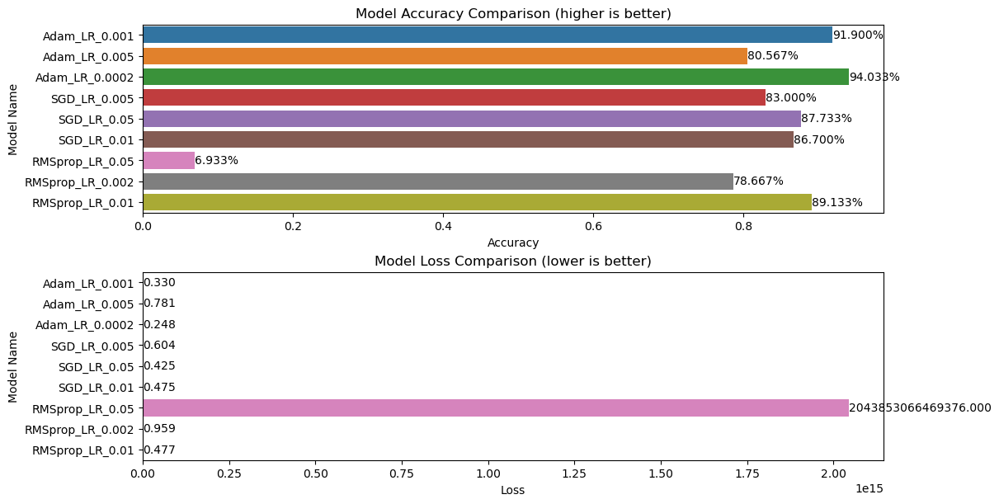

In [28]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.optimizers import RMSprop
optimizer_list = [
    Adam(),
    Adam(learning_rate=0.005),
    Adam(learning_rate=0.0002),
    SGD(learning_rate=0.005),
    SGD(learning_rate=0.05),
    SGD(),
    RMSprop(learning_rate=0.05),
    RMSprop(learning_rate=0.002),
    RMSprop(),
]

name_list = [
    'Adam_LR_0.001',
    'Adam_LR_0.005',
    'Adam_LR_0.0002',
    'SGD_LR_0.005',
    'SGD_LR_0.05',
    'SGD_LR_0.01',
    'RMSprop_LR_0.05',
    'RMSprop_LR_0.002',
    'RMSprop_LR_0.01'
]

tuned_31_Adam_LR_0_001 = load_model('res31_best.h5')
tuned_31_Adam_LR_0_005 = load_model('res31_best.h5')
tuned_31_Adam_LR_0_0002 = load_model('res31_best.h5')
tuned_31_SGD_LR_0_005 = load_model('res31_best.h5')
tuned_31_SGD_LR_0_05 = load_model('res31_best.h5')
tuned_31_SGD_LR_0_01 = load_model('res31_best.h5')
tuned_31_RMSprop_LR_0_05 = load_model('res31_best.h5')
tuned_31_RMSprop_LR_0_002 = load_model('res31_best.h5')
tuned_31_RMSprop_LR_0_01 = load_model('res31_best.h5')


output_list = [tuned_31_Adam_LR_0_001, tuned_31_Adam_LR_0_005, tuned_31_Adam_LR_0_0002, tuned_31_SGD_LR_0_005, tuned_31_SGD_LR_0_05, tuned_31_SGD_LR_0_01, tuned_31_RMSprop_LR_0_05, tuned_31_RMSprop_LR_0_002, tuned_31_RMSprop_LR_0_01]

data_list = [std_res31_validation, std_res31_validation, std_res31_validation, std_res31_validation, std_res31_validation, std_res31_validation, std_res31_validation, std_res31_validation, std_res31_validation]

model_hypertuner(optimizer_list, name_list, output_list)
cnnf.model_comparison(output_list, data_list, name_list)

From the above, we can see that Adam is still the best optimizer for the model, and especially when it has a learning rate of 0.0002. We shall save this model again, so that we do not lose our progress, and run it using the test dataset to see it's final performance.
Before we evaluate the model's performance on the test dataset, we shall allow the model to train for another 50 epochs, allow for it to perform to the best of it's ability.

Epoch 1/50
283/283 [==============================] - 11s 38ms/step - loss: 0.0639 - accuracy: 0.9809 - val_loss: 0.2376 - val_accuracy: 0.9450
Epoch 2/50
283/283 [==============================] - 11s 38ms/step - loss: 0.0663 - accuracy: 0.9772 - val_loss: 0.2423 - val_accuracy: 0.9427
Epoch 3/50
283/283 [==============================] - 11s 38ms/step - loss: 0.0673 - accuracy: 0.9774 - val_loss: 0.2088 - val_accuracy: 0.9467
Epoch 4/50
283/283 [==============================] - 11s 37ms/step - loss: 0.0540 - accuracy: 0.9822 - val_loss: 0.2266 - val_accuracy: 0.9460
Epoch 5/50
283/283 [==============================] - 10s 36ms/step - loss: 0.0585 - accuracy: 0.9790 - val_loss: 0.2071 - val_accuracy: 0.9500
Epoch 6/50
283/283 [==============================] - 10s 36ms/step - loss: 0.0550 - accuracy: 0.9818 - val_loss: 0.2033 - val_accuracy: 0.9507
Epoch 7/50
283/283 [==============================] - 10s 35ms/step - loss: 0.0519 - accuracy: 0.9822 - val_loss: 0.1963 - val_accuracy:

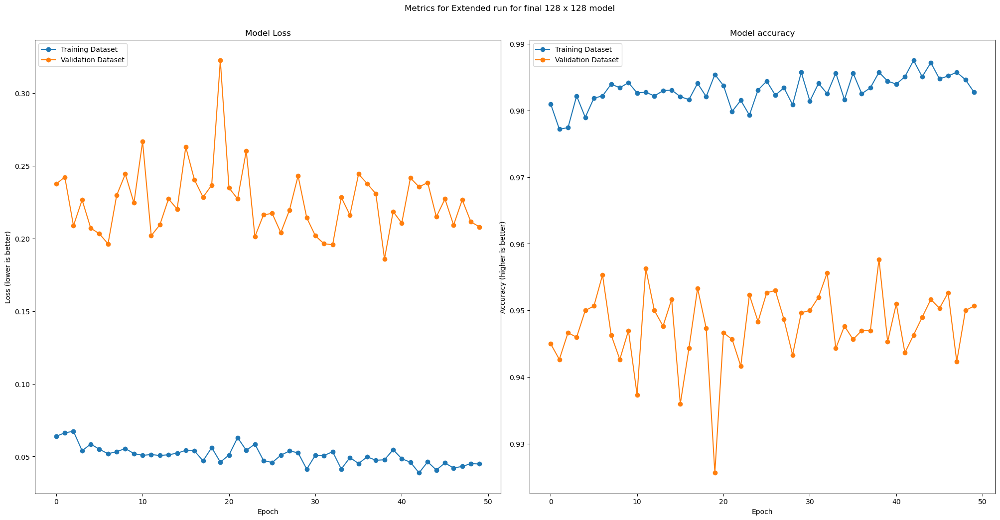

In [62]:
history = tuned_31_Adam_LR_0_0002.fit(aug_res31_train, validation_data = std_res31_validation, epochs = 50, class_weight = class_weights)
cnnf.model_metric_graph(history, tuned_31_Adam_LR_0_0002, std_res128_validation, name = "Extended run for final 128 x 128", class_names = class_names)

In [66]:
tuned_31_Adam_LR_0_0002.save("res31_best_tuned.h5")
tuned_31_Adam_LR_0_0002.save_weights("res31_best_tuned_weights.h5")

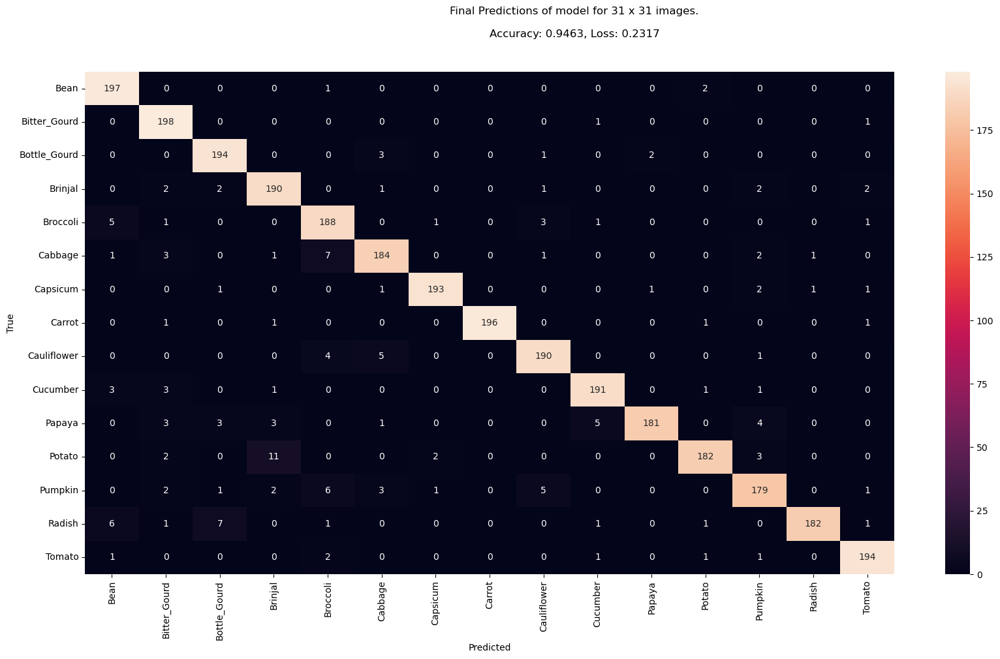

In [67]:
from sklearn.metrics import accuracy_score
from tensorflow.keras.losses import SparseCategoricalCrossentropy

def predict_in_batches(model, dataset, batch_size=32):
    predictions = []
    true_labels = []

    for batch_data, labels in dataset.as_numpy_iterator():
        batch_predictions = model.predict(batch_data)
        clear_output(wait=True)
        predictions.append(batch_predictions)
        true_labels.append(labels)

    return np.concatenate(predictions, axis=0), np.concatenate(true_labels, axis = 0)

predictions, true_labels = predict_in_batches(tuned_31_Adam_LR_0_0002, std_res31_test, batch_size=32)


scce = SparseCategoricalCrossentropy()
fig = plt.figure(figsize = (20,10))
sns.heatmap(confusion_matrix(true_labels, np.argmax(predictions, axis = 1)), annot = True, xticklabels = class_names, yticklabels = class_names, fmt = "g")
plt.suptitle(f"Final Predictions of model for 31 x 31 images.\n\nAccuracy: {accuracy_score(true_labels, np.argmax(predictions, axis = 1)):.4f}, Loss: {scce(true_labels, predictions).numpy():.4f}")
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

We can see that the final model performs quite well, with a accuracy of 94%. We can see that for the most part, the model seems to be able to predict most vegetables correctly, except for Potatoes, which it seems to think are brinjals. Apart from that, the model makes a few mistakes here and there, but is still able to capture most of the detail in the dataset.

<hr>
<font size = 5>Model Hypertuning (128 x 128)</font>
<hr>

In [30]:
def model_hypertuner_128(optimizer_list, name_list, model_list):
    for optimizer, name, model in zip(optimizer_list, name_list, model_list):
        clear_output(wait=True)
        print(f"Now attempting to tune {name}")
        model.compile(optimizer = optimizer, loss = "sparse_categorical_crossentropy", metrics=['accuracy'])
        model.fit(aug_res128_train, validation_data = std_res128_validation, epochs = 75, callbacks = earlyStopper, class_weight = class_weights)
        gc.collect()


Now attempting to tune RMSprop_LR_0.01
Epoch 1/75
283/283 [==============================] - 65s 218ms/step - loss: 0.0714 - accuracy: 0.9813 - val_loss: 0.2232 - val_accuracy: 0.9563
Epoch 2/75
283/283 [==============================] - 61s 213ms/step - loss: 0.0524 - accuracy: 0.9854 - val_loss: 0.1875 - val_accuracy: 0.9547
Epoch 3/75
283/283 [==============================] - 62s 217ms/step - loss: 0.0467 - accuracy: 0.9872 - val_loss: 0.1648 - val_accuracy: 0.9663
Epoch 4/75
283/283 [==============================] - 61s 215ms/step - loss: 0.0553 - accuracy: 0.9826 - val_loss: 0.1532 - val_accuracy: 0.9647
Epoch 5/75
283/283 [==============================] - 61s 213ms/step - loss: 0.0464 - accuracy: 0.9868 - val_loss: 0.1049 - val_accuracy: 0.9787
Epoch 6/75
283/283 [==============================] - 63s 220ms/step - loss: 0.0479 - accuracy: 0.9873 - val_loss: 0.1535 - val_accuracy: 0.9723
Epoch 7/75
283/283 [==============================] - 63s 220ms/step - loss: 0.0582 - accur

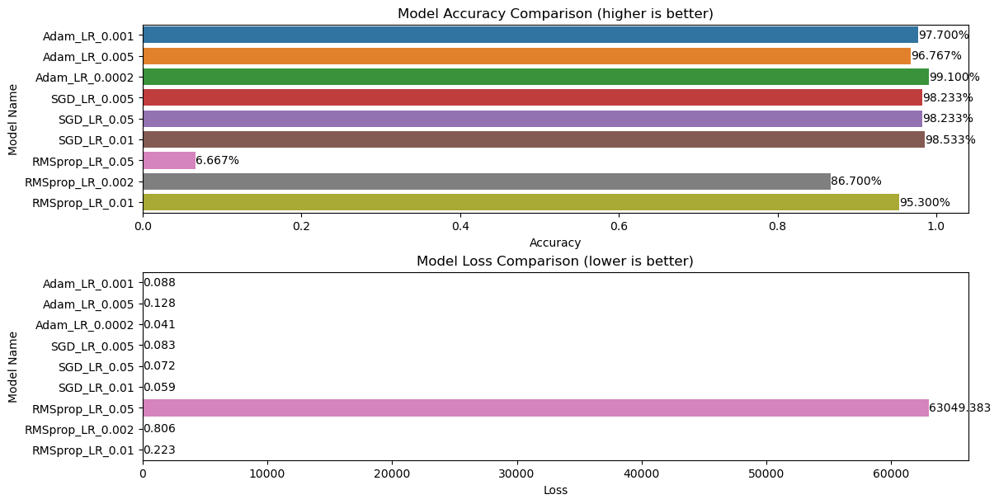

In [35]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.optimizers import RMSprop
optimizer_list = [
    Adam(),
    Adam(learning_rate=0.005),
    Adam(learning_rate=0.0002),
    SGD(learning_rate=0.005),
    SGD(learning_rate=0.05),
    SGD(),
    RMSprop(learning_rate=0.05),
    RMSprop(learning_rate=0.002),
    RMSprop(),
]

name_list = [
    'Adam_LR_0.001',
    'Adam_LR_0.005',
    'Adam_LR_0.0002',
    'SGD_LR_0.005',
    'SGD_LR_0.05',
    'SGD_LR_0.01',
    'RMSprop_LR_0.05',
    'RMSprop_LR_0.002',
    'RMSprop_LR_0.01'
]

tuned_128_Adam_LR_0_001 = load_model('res128_best.h5')
tuned_128_Adam_LR_0_005 = load_model('res128_best.h5')
tuned_128_Adam_LR_0_0002 = load_model('res128_best.h5')
tuned_128_SGD_LR_0_005 = load_model('res128_best.h5')
tuned_128_SGD_LR_0_05 = load_model('res128_best.h5')
tuned_128_SGD_LR_0_01 = load_model('res128_best.h5')
tuned_128_RMSprop_LR_0_05 = load_model('res128_best.h5')
tuned_128_RMSprop_LR_0_002 = load_model('res128_best.h5')
tuned_128_RMSprop_LR_0_01 = load_model('res128_best.h5')


output_list = [tuned_128_Adam_LR_0_001, tuned_128_Adam_LR_0_005, tuned_128_Adam_LR_0_0002, tuned_128_SGD_LR_0_005, tuned_128_SGD_LR_0_05, tuned_128_SGD_LR_0_01, tuned_128_RMSprop_LR_0_05, tuned_128_RMSprop_LR_0_002, tuned_128_RMSprop_LR_0_01]

data_list = [std_res128_validation, std_res128_validation, std_res128_validation, std_res128_validation, std_res128_validation, std_res128_validation, std_res128_validation, std_res128_validation, std_res128_validation]

model_hypertuner_128(optimizer_list, name_list, output_list)
cnnf.model_comparison(output_list, data_list, name_list)

From the above, we can see that Adam is still the best optimizer for the model, and especially when it has a learning rate of 0.0002. We shall save this model again, so that we do not lose our progress, and run it using the test dataset to see it's final performance.
Before we evaluate the model's performance on the test dataset, we shall allow the model to train for another 50 epochs, allow for it to perform to the best of it's ability.

Epoch 1/50
283/283 [==============================] - 62s 217ms/step - loss: 0.0115 - accuracy: 0.9967 - val_loss: 0.0422 - val_accuracy: 0.9917
Epoch 2/50
283/283 [==============================] - 59s 208ms/step - loss: 0.0137 - accuracy: 0.9961 - val_loss: 0.0468 - val_accuracy: 0.9897
Epoch 3/50
283/283 [==============================] - 61s 216ms/step - loss: 0.0122 - accuracy: 0.9967 - val_loss: 0.0477 - val_accuracy: 0.9900
Epoch 4/50
283/283 [==============================] - 61s 216ms/step - loss: 0.0094 - accuracy: 0.9977 - val_loss: 0.0389 - val_accuracy: 0.9913
Epoch 5/50
283/283 [==============================] - 62s 216ms/step - loss: 0.0088 - accuracy: 0.9979 - val_loss: 0.0474 - val_accuracy: 0.9893
Epoch 6/50
283/283 [==============================] - 61s 216ms/step - loss: 0.0113 - accuracy: 0.9975 - val_loss: 0.0557 - val_accuracy: 0.9897
Epoch 7/50
283/283 [==============================] - 62s 217ms/step - loss: 0.0117 - accuracy: 0.9969 - val_loss: 0.0529 - val_ac

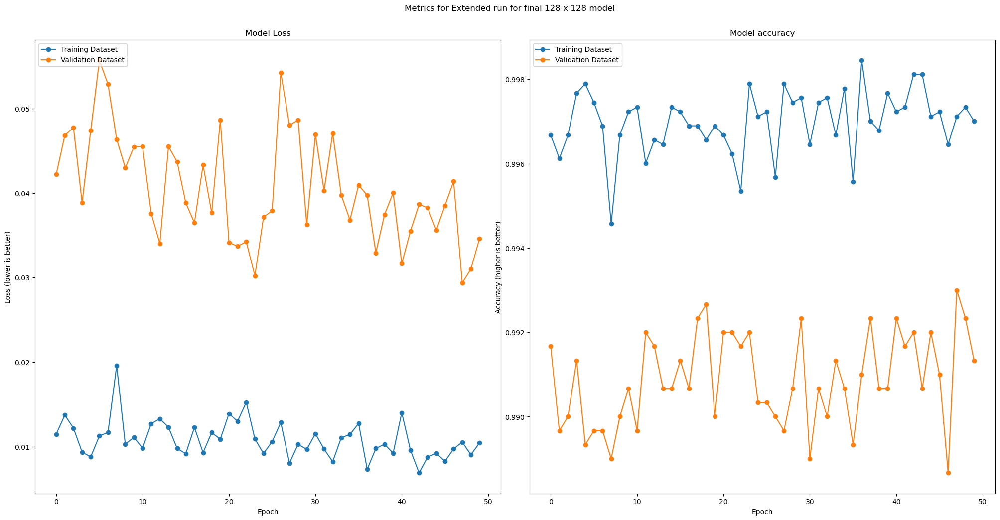

In [63]:
history = tuned_128_Adam_LR_0_0002.fit(aug_res128_train, validation_data = std_res128_validation, epochs = 50, class_weight = class_weights)
cnnf.model_metric_graph(history, tuned_128_Adam_LR_0_0002, std_res128_validation, name = "Extended run for final 128 x 128", class_names = class_names)

In [64]:
tuned_128_Adam_LR_0_0002.save("res128_best_tuned.h5")
tuned_128_Adam_LR_0_0002.save_weights("res128_best_tuned_weights.h5")

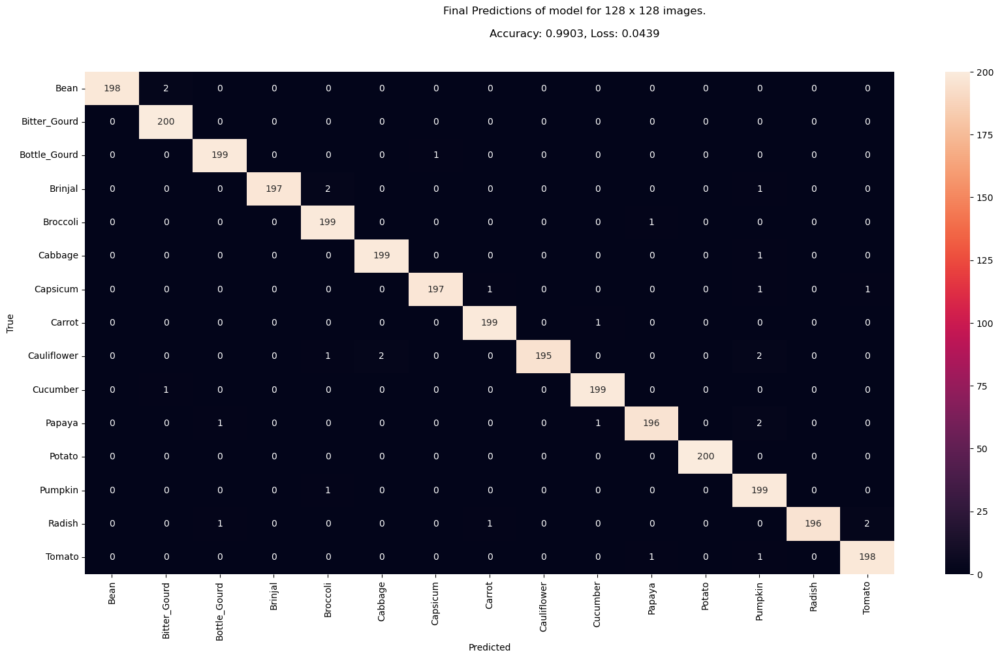

In [68]:
from sklearn.metrics import accuracy_score
from tensorflow.keras.losses import SparseCategoricalCrossentropy

def predict_in_batches(model, dataset, batch_size=32):
    predictions = []
    true_labels = []

    for batch_data, labels in dataset.as_numpy_iterator():
        batch_predictions = model.predict(batch_data)
        clear_output(wait=True)
        predictions.append(batch_predictions)
        true_labels.append(labels)

    return np.concatenate(predictions, axis=0), np.concatenate(true_labels, axis = 0)

predictions, true_labels = predict_in_batches(tuned_128_Adam_LR_0_0002, std_res128_test, batch_size=32)


scce = SparseCategoricalCrossentropy()
fig = plt.figure(figsize = (20,10))
sns.heatmap(confusion_matrix(true_labels, np.argmax(predictions, axis = 1)), annot = True, xticklabels = class_names, yticklabels = class_names, fmt = "g")
plt.suptitle(f"Final Predictions of model for 128 x 128 images.\n\nAccuracy: {accuracy_score(true_labels, np.argmax(predictions, axis = 1)):.4f}, Loss: {scce(true_labels, predictions).numpy():.4f}")
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

The model performs extremely well on the `128 x 128` dataset, capturing most, if not all of the detail in the dataset, and it reflects in the results. With a accuracy of 99.03% on the test dataset, the model is almost perfect. It does make a few mistakes here and there, but that may be due to inconsistencies in the test data.

<hr>
<font size = 5>Conclusions</font>
<hr>

To conclude, this exercise has allowed me to learn alot more about the field of deep learning, and the considerations that have to be made when attempting to craft a tool for a task. One part where I understand better are the limitations placed on us, especially regarding the greyscaling and resolution constraints. From the above, it can be seen that the models perform better when given more data (94% on 31 x 31, and 99% on 128 x 128). However, a larger amount of imperfect data is already hard to get, given other constraints, let alone data that is perfectly sized, processed and prepared. From this assignment, we can also see the effects of different ways to improve performance, such as class weights, augmentation etc., and how they affect the model in general.

<font size = 1>Saving weights.</font>